# Face Generation

In this project, you'll define and train a Generative Adverserial network of your own creation on a dataset of faces. Your goal is to get a generator network to generate *new* images of faces that look as realistic as possible!

The project will be broken down into a series of tasks from **defining new architectures training adversarial networks**. At the end of the notebook, you'll be able to visualize the results of your trained Generator to see how it performs; your generated samples should look like fairly realistic faces with small amounts of noise.

### Get the Data

You'll be using the [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) to train your adversarial networks.

This dataset has higher resolution images than datasets you have previously worked with (like MNIST or SVHN) you've been working with, and so, you should prepare to define deeper networks and train them for a longer time to get good results. It is suggested that you utilize a GPU for training.

### Pre-processed Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. Some sample data is show below.

<img src='assets/processed_face_data.png' width=60% />

> If you are working locally, you can download this data [by clicking here](https://s3.amazonaws.com/video.udacity-data.com/topher/2018/November/5be7eb6f_processed-celeba-small/processed-celeba-small.zip)

This is a zip file that you'll need to extract in the home directory of this notebook for further loading and processing. After extracting the data, you should be left with a directory of data `processed-celeba-small/`.

In [2]:
# Pre-requisite: Select PyTorch 2.0.0 kernel

In [3]:
# Rubric: https://review.udacity.com/#!/rubrics/4801/view


In [4]:
# run this once to unzip the file
# !unzip processed-celeba-small.zip

In [5]:
# TODOs
# - calculate FID score
# - weight initialization

In [6]:
from glob import glob
from typing import Tuple, Callable, Dict

import matplotlib.pyplot as plt
import numpy as np
import torch
from PIL import Image
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import Compose, ToTensor
from torchvision import datasets
import torchvision
import os
import multiprocessing
from tqdm import tqdm

import tests

device = 'cuda'


In [7]:
data_dir = 'processed-celeba-small/celeba'

## Data pipeline

The [CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations. Since you're going to be generating faces, you won't need the annotations, you'll only need the images. Note that these are color images with [3 color channels (RGB)](https://en.wikipedia.org/wiki/Channel_(digital_image)#RGB_Images) each.

### Pre-process and Load the Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. This *pre-processed* dataset is a smaller subset of the very large CelebA dataset and contains roughly 30,000 images. 

Your first task consists in building the dataloader. To do so, you need to do the following:
* implement the get_transforms function
* create a custom Dataset class that reads the CelebA data

### Exercise: implement the get_transforms function

The `get_transforms` function should output a [`torchvision.transforms.Compose`](https://pytorch.org/vision/stable/generated/torchvision.transforms.Compose.html#torchvision.transforms.Compose) of different transformations. You have two constraints:
* the function takes a tuple of size as input and should **resize the images** to the input size
* the output images should have values **ranging from -1 to 1**

In [8]:
def get_transforms(size: Tuple[int, int]) -> Callable:
    """ Transforms to apply to the image."""
    # TODO: edit this function by appening transforms to the below list
        
    transforms = [
        torchvision.transforms.Resize(size),   
        torchvision.transforms.ToTensor(),
        torchvision.transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ]        
    
    return Compose(transforms)

### Exercise: implement the DatasetDirectory class


The `DatasetDirectory` class is a torch Dataset that reads from the above data directory. The `__getitem__` method should output a transformed tensor and the `__len__` method should output the number of files in our dataset. You can look at [this custom dataset](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html#creating-a-custom-dataset-for-your-files) for ideas. 

In [9]:
class DatasetDirectory(Dataset):
    """
    A custom dataset class that loads images from folder.
    args:
    - directory: location of the images
    - transform: transform function to apply to the images
    - extension: file format
    """
    def __init__(self, 
                 directory: str, 
                 transforms: Callable = None, 
                 extension: str = '.jpg'):
        # TODO: implement the init method
        
        self.directory = directory
        self.transforms = transforms
        self.extension = extension
        self.filenames = [f for f in os.listdir(directory) if f.endswith(extension)]


    def __len__(self) -> int:
        """ returns the number of items in the dataset """
        # TODO: return the number of elements in the dataset
        return len(self.filenames)

    def __getitem__(self, index: int) -> torch.Tensor:
        """ load an image and apply transformation """
        # TODO: return the index-element of the dataset
        
        filename = self.filenames[index]
        filepath = os.path.join(self.directory, filename)
        image = Image.open(filepath)
        
        if self.transforms:
            image = self.transforms(image)
        
        return image        

In [10]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your dataset implementation
dataset = DatasetDirectory(data_dir, get_transforms((64, 64)))
tests.check_dataset_outputs(dataset)

Congrats, your dataset implementation passed all the tests


The functions below will help you visualize images from the dataset.

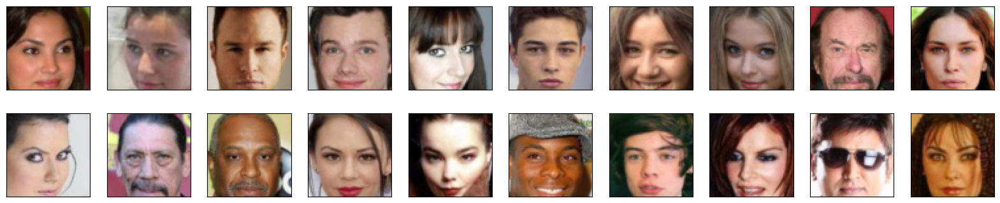

In [11]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def denormalize(images):
    """Transform images from [-1.0, 1.0] to [0, 255] and cast them to uint8."""
    return ((images + 1.) / 2. * 255).astype(np.uint8)

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(20, 4))
plot_size=20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
    img = dataset[idx].numpy()
    img = np.transpose(img, (1, 2, 0))
    img = denormalize(img)
    ax.imshow(img)

## Model implementation

As you know, a GAN is comprised of two adversarial networks, a discriminator and a generator. Now that we have a working data pipeline, we need to implement the discriminator and the generator. 

Feel free to implement any additional class or function.

### Exercise: Create the discriminator

The discriminator's job is to score real and fake images. You have two constraints here:
* the discriminator takes as input a **batch of 64x64x3 images**
* the output should be a single value (=score)

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips
* To scale down from the input image, you can either use `Conv2d` layers with the correct hyperparameters or Pooling layers.
* If you plan on using gradient penalty, do not use Batch Normalization layers in the discriminator.

In [12]:
from torch.nn import Module
import torch.nn as nn
import torch.nn.functional as F

In [13]:
def conv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    """Creates a convolutional layer, with optional batch normalization.
    """
    layers = []
    conv_layer = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, 
                           kernel_size=kernel_size, stride=stride, padding=padding, bias=False)
    
    layers.append(conv_layer)

    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    return nn.Sequential(*layers)

class Discriminator(Module):
    def __init__(self, conv_dim=64):
        super(Discriminator, self).__init__()
        # TODO: instantiate the different layers
        
        # Convolutional layers, increasing in depth
        # first layer has *no* batchnorm
        self.conv1 = conv(3, conv_dim, 4, batch_norm=False) # x, y = 64, depth 64  (64, 64, 3) -> (32, 32, 64)
        self.conv2 = conv(conv_dim, conv_dim*2, 4) # (32, 32, 128)                 (32, 32, 64) -> (16, 16, 128)
        self.conv3 = conv(conv_dim*2, conv_dim*4, 4) # (16, 16, 256)               (16, 16, 128) -> (8, 8, 256)
        self.conv4 = conv(conv_dim*4, conv_dim*8, 4) # (8, 8, 512)                 (8, 8, 256) -> (4, 4, 512)
        
        self.conv5 = conv(conv_dim*8, 1, 4, stride=1, padding=0, batch_norm=False) # (4, 4, 512) -> (1, 1, 1)    
        
        # self.activation = F.relu
        self.activation = nn.LeakyReLU(0.2)
        
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # TODO: implement the forward method
        
        out = self.activation(self.conv1(x))
        out = self.activation(self.conv2(out))
        out = self.activation(self.conv3(out))
        out = self.activation(self.conv4(out))
        
        # out = self.flatten(out)
        # out = self.fc(out)
        
        # last, classification layer        
        out = self.conv5(out)
        
        return out

In [14]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to check your discriminator implementation
discriminator = Discriminator()

print(discriminator)
tests.check_discriminator(discriminator)

Discriminator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv5): Sequential(
    (0): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
  (activation): LeakyReLU(negative_slope=0.2)
)
Congrats, your discriminator implementation passed all the tests


### Exercise: create the generator

The generator's job creates the "fake images" and learns the dataset distribution. You have three constraints here:
* the generator takes as input a vector of dimension `[batch_size, latent_dimension, 1, 1]`
* the generator must outputs **64x64x3 images**

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips:
* to scale up from the latent vector input, you can use `ConvTranspose2d` layers
* as often with Gan, **Batch Normalization** helps with training

In [15]:
# helper deconv function
def deconv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    """Creates a transposed-convolutional layer, with optional batch normalization.
    """
    # create a sequence of transpose + optional batch norm layers
    layers = []
    transpose_conv_layer = nn.ConvTranspose2d(in_channels, out_channels, 
                                              kernel_size, stride, padding, bias=False)
    # append transpose convolutional layer
    layers.append(transpose_conv_layer)
    
    if batch_norm:
        # append batchnorm layer
        layers.append(nn.BatchNorm2d(out_channels))
        
    return nn.Sequential(*layers)

class Generator(Module):
    def __init__(self, latent_dim: int):
        super(Generator, self).__init__()
        # TODO: instantiate the different layers
      
        # First deconv layer: Takes latent vector input and outputs a feature map
        self.deconv1 = deconv(latent_dim, 1024, kernel_size=4, stride=1, padding=0, batch_norm=True)
        
        # Second deconv layer: Upsamples the feature map to a larger size
        self.deconv2 = deconv(1024, 512, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Third deconv layer
        self.deconv3 = deconv(512, 256, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Fourth deconv layer
        self.deconv4 = deconv(256, 128, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Fifth deconv layer: Outputs the final 64x64x3 image
        self.deconv5 = deconv(128, 3, kernel_size=4, stride=2, padding=1, batch_norm=False)


    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # TODO: implement the forward method

        x = F.relu(self.deconv1(x))
        x = F.relu(self.deconv2(x))
        x = F.relu(self.deconv3(x))
        x = F.relu(self.deconv4(x))
        
        # Apply Tanh activation to the output of the final deconv layer
        x = torch.tanh(self.deconv5(x))
        
        return x

In [16]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your generator implementation
latent_dim = 128
generator = Generator(latent_dim)
tests.check_generator(generator, latent_dim)

Congrats, your generator implementation passed all the tests


## Optimizer

In the following section, we create the optimizers for the generator and discriminator. You may want to experiment with different optimizers, learning rates and other hyperparameters as they tend to impact the output quality.

### Exercise: implement the optimizers

In [17]:
import torch.optim as optim


def create_optimizers(generator: Module, discriminator: Module):    
    lr = 0.0002
    betal=0.5
    beta2=0.999 # default value

    """ This function should return the optimizers of the generator and the discriminator """
    g_optimizer = optim.Adam(generator.parameters(), lr, [betal, beta2])
    d_optimizer = optim.Adam(discriminator.parameters(), lr, [betal, beta2])
    
    return g_optimizer, d_optimizer

## Losses implementation

In this section, we are going to implement the loss function for the generator and the discriminator. You can and should experiment with different loss function.

Some tips:
* You can choose the commonly used the binary cross entropy loss or select other losses we have discovered in the course, such as the Wasserstein distance.
* You may want to implement a gradient penalty function as discussed in the course. It is not required and the code will work whether you implement it or not.

### Exercise: implement the generator loss

The generator's goal is to get the discriminator to think its generated images (= "fake" images) are real.

In [18]:
def real_loss(D_out, smooth=False):
    batch_size = D_out.size(0)

    # label smoothing
    if smooth:
        # smooth, real labels = 0.9
        labels = torch.ones(batch_size)*0.9
    else:
        labels = torch.ones(batch_size) # real labels = 1

    labels = labels.to(device)        
    criterion = nn.BCEWithLogitsLoss()
    loss = criterion(D_out.squeeze(), labels)
    
    return loss

def fake_loss(D_out):
    batch_size = D_out.size(0)
    
    labels = torch.zeros(batch_size) # fake labels = 0
    
    labels = labels.to(device)    
    criterion = nn.BCEWithLogitsLoss()    
    loss = criterion(D_out.squeeze(), labels)
    
    return loss

In [19]:
def generator_loss(fake_logits):
    """ Generator loss, takes the fake scores as inputs. """
    # TODO: implement the generator loss 
    
    # use real loss to flip labels
    loss = real_loss(fake_logits)
    
    return loss

### Exercise: implement the discriminator loss

We want the discriminator to give high scores to real images and low scores to fake ones and the discriminator loss should reflect that.

In [20]:
def discriminator_loss(real_logits, fake_logits):
    """ Discriminator loss, takes the fake and real logits as inputs. """
    # TODO: implement the discriminator loss 
        
    d_real_loss = real_loss(real_logits)    
    d_fake_loss = fake_loss(fake_logits)
            
    loss = d_real_loss + d_fake_loss
    
    return loss

### Exercise (Optional): Implement the gradient Penalty

In the course, we discussed the importance of gradient penalty in training certain types of Gans. Implementing this function is not required and depends on some of the design decision you made (discriminator architecture, loss functions).

In [21]:
def gradient_penalty(discriminator, real_samples, fake_samples):
    """ This function enforces """
    gp = 0
    
    # TODO (Optional): implement the gradient penalty
    return gp

## Training


Training will involve alternating between training the discriminator and the generator. You'll use your functions real_loss and fake_loss to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function

### Exercise: implement the generator step and the discriminator step functions

Each function should do the following:
* calculate the loss
* backpropagate the gradient
* perform one optimizer step

### Main training loop

You don't have to implement anything here but you can experiment with different hyperparameters.

In [22]:
from datetime import datetime

In [23]:
# you can experiment with different dimensions of latent spaces
latent_dim = 128

# update to cpu if you do not have access to a gpu
# device = 'cuda'

# number of epochs to train your model
n_epochs = 50

# number of images in each batch
batch_size = 128

In [24]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
print_every = 50

# Create optimizers for the discriminator D and generator G
generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)
g_optimizer, d_optimizer = create_optimizers(generator, discriminator)

dataloader = DataLoader(dataset, 
                        batch_size=64, 
                        shuffle=True, 
                        num_workers=4, 
                        drop_last=True,
                        pin_memory=False)

In [25]:
def generator_step(batch_size: int, latent_dim: int) -> Dict:
    """ One training step of the generator. """
    # TODO: implement the generator step (foward pass, loss calculation and backward pass)
    
    g_optimizer.zero_grad()
        
    # 1. Train with fake images and flipped labels
        
    # Generate fake images
    z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    z = torch.from_numpy(z).float()[:,:,None,None]
                
    # z = torch.rand(batch_size, latent_dim, 1, 1) * 2 - 1
        
    # z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    # z = torch.from_numpy(z).float()
                
    z = z.to(device)
        
    fake_images = generator(z)
        
    # Compute the discriminator losses on fake images 
    # using flipped labels!
    D_fake = discriminator(fake_images)
                        
    # g_loss = real_loss(D_fake) # use real loss to flip labels
    g_loss = generator_loss(D_fake)
        
    # perform backprop
    g_loss.backward()
        
    g_optimizer.step()
        
    return {'loss': g_loss}


def discriminator_step(batch_size: int, latent_dim: int, real_images: torch.Tensor) -> Dict:
    """ One training step of the discriminator. """
    # TODO: implement the discriminator step (foward pass, loss calculation and backward pass)

    d_optimizer.zero_grad()
        
    # 1. Train with real images

    # Compute the discriminator losses on real images 
        
    D_real = discriminator(real_images)
    # d_real_loss = real_loss(D_real)
        
    # 2. Train with fake images
        
    # Generate fake images
    z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    z = torch.from_numpy(z).float()[:,:,None,None]
        
    # z = torch.rand(batch_size, latent_dim, 1, 1) * 2 - 1                
        
    # z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    # z = torch.from_numpy(z).float()
    z = z.to(device)
        
    fake_images = generator(z)
        
    # Compute the discriminator losses on fake images            
    D_fake = discriminator(fake_images)
    # d_fake_loss = fake_loss(D_fake)
        
    # add up loss and perform backprop
    # d_loss = d_real_loss + d_fake_loss
        
    d_loss = discriminator_loss(D_real, D_fake)
        
    d_loss.backward()
        
    d_optimizer.step()
        
    gp = None
    
    return {'loss': d_loss, 'gp': gp}

In [26]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def display(fixed_latent_vector: torch.Tensor):
    """ helper function to display images during training """
    fig = plt.figure(figsize=(14, 4))
    plot_size = 16
    for idx in np.arange(plot_size):
        ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
        img = fixed_latent_vector[idx, ...].detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = denormalize(img)
        ax.imshow(img)
    plt.show()

### Exercise: implement the training strategy

You should experiment with different training strategies. For example:

* train the generator more often than the discriminator. 
* added noise to the input image
* use label smoothing

Implement with your training strategy below.

2024-01-20 14:18:14 | Epoch [1/50] | Batch 0/509 | d_loss: 1.3902 | g_loss: 2.3629
2024-01-20 14:18:16 | Epoch [1/50] | Batch 50/509 | d_loss: 0.2169 | g_loss: 7.5549
2024-01-20 14:18:19 | Epoch [1/50] | Batch 100/509 | d_loss: 0.8093 | g_loss: 3.2878
2024-01-20 14:18:22 | Epoch [1/50] | Batch 150/509 | d_loss: 0.5389 | g_loss: 2.1396
2024-01-20 14:18:25 | Epoch [1/50] | Batch 200/509 | d_loss: 0.5937 | g_loss: 2.6820
2024-01-20 14:18:28 | Epoch [1/50] | Batch 250/509 | d_loss: 1.2262 | g_loss: 2.2538
2024-01-20 14:18:31 | Epoch [1/50] | Batch 300/509 | d_loss: 0.6478 | g_loss: 2.5944
2024-01-20 14:18:34 | Epoch [1/50] | Batch 350/509 | d_loss: 0.7770 | g_loss: 2.6049
2024-01-20 14:18:37 | Epoch [1/50] | Batch 400/509 | d_loss: 1.1049 | g_loss: 2.3277
2024-01-20 14:18:40 | Epoch [1/50] | Batch 450/509 | d_loss: 1.0228 | g_loss: 3.4561
2024-01-20 14:18:43 | Epoch [1/50] | Batch 500/509 | d_loss: 0.5448 | g_loss: 2.3772


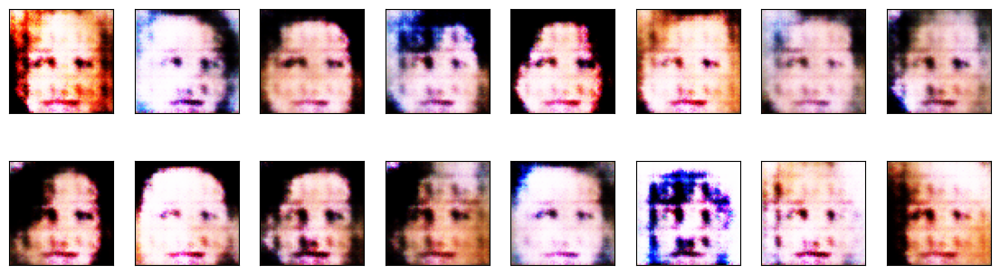

2024-01-20 14:18:44 | Epoch [2/50] | Batch 0/509 | d_loss: 1.2097 | g_loss: 2.9047
2024-01-20 14:18:47 | Epoch [2/50] | Batch 50/509 | d_loss: 0.4638 | g_loss: 4.1037
2024-01-20 14:18:50 | Epoch [2/50] | Batch 100/509 | d_loss: 0.6414 | g_loss: 3.4368
2024-01-20 14:18:53 | Epoch [2/50] | Batch 150/509 | d_loss: 0.6024 | g_loss: 2.6045
2024-01-20 14:18:56 | Epoch [2/50] | Batch 200/509 | d_loss: 1.0150 | g_loss: 2.8296
2024-01-20 14:18:59 | Epoch [2/50] | Batch 250/509 | d_loss: 1.1235 | g_loss: 2.5532
2024-01-20 14:19:02 | Epoch [2/50] | Batch 300/509 | d_loss: 0.8610 | g_loss: 3.8137
2024-01-20 14:19:05 | Epoch [2/50] | Batch 350/509 | d_loss: 0.5275 | g_loss: 3.8660
2024-01-20 14:19:08 | Epoch [2/50] | Batch 400/509 | d_loss: 0.3253 | g_loss: 2.3351
2024-01-20 14:19:10 | Epoch [2/50] | Batch 450/509 | d_loss: 0.2244 | g_loss: 2.6227
2024-01-20 14:19:13 | Epoch [2/50] | Batch 500/509 | d_loss: 0.6661 | g_loss: 2.1997


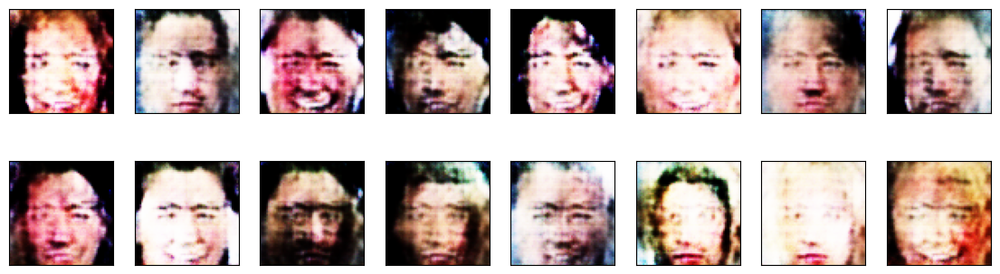

2024-01-20 14:19:15 | Epoch [3/50] | Batch 0/509 | d_loss: 0.6321 | g_loss: 2.6687
2024-01-20 14:19:17 | Epoch [3/50] | Batch 50/509 | d_loss: 2.3394 | g_loss: 2.6408
2024-01-20 14:19:20 | Epoch [3/50] | Batch 100/509 | d_loss: 0.7549 | g_loss: 2.2881
2024-01-20 14:19:23 | Epoch [3/50] | Batch 150/509 | d_loss: 0.5911 | g_loss: 1.8101
2024-01-20 14:19:26 | Epoch [3/50] | Batch 200/509 | d_loss: 0.1656 | g_loss: 3.3282
2024-01-20 14:19:29 | Epoch [3/50] | Batch 250/509 | d_loss: 1.0426 | g_loss: 2.1588
2024-01-20 14:19:32 | Epoch [3/50] | Batch 300/509 | d_loss: 1.7344 | g_loss: 2.8918
2024-01-20 14:19:35 | Epoch [3/50] | Batch 350/509 | d_loss: 0.9527 | g_loss: 6.5393
2024-01-20 14:19:38 | Epoch [3/50] | Batch 400/509 | d_loss: 0.3111 | g_loss: 3.2028
2024-01-20 14:19:41 | Epoch [3/50] | Batch 450/509 | d_loss: 0.8449 | g_loss: 5.3005
2024-01-20 14:19:44 | Epoch [3/50] | Batch 500/509 | d_loss: 0.2176 | g_loss: 3.2653


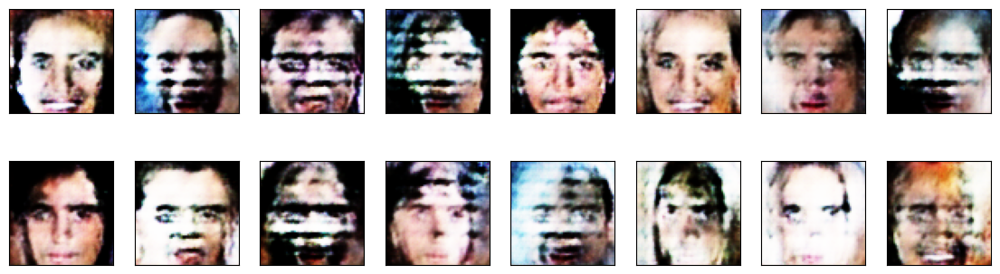

2024-01-20 14:19:45 | Epoch [4/50] | Batch 0/509 | d_loss: 0.6797 | g_loss: 4.8707
2024-01-20 14:19:48 | Epoch [4/50] | Batch 50/509 | d_loss: 0.4231 | g_loss: 3.7005
2024-01-20 14:19:51 | Epoch [4/50] | Batch 100/509 | d_loss: 0.2994 | g_loss: 3.0684
2024-01-20 14:19:54 | Epoch [4/50] | Batch 150/509 | d_loss: 0.1656 | g_loss: 3.5631
2024-01-20 14:19:57 | Epoch [4/50] | Batch 200/509 | d_loss: 0.3476 | g_loss: 2.9484
2024-01-20 14:20:00 | Epoch [4/50] | Batch 250/509 | d_loss: 1.9571 | g_loss: 4.0383
2024-01-20 14:20:02 | Epoch [4/50] | Batch 300/509 | d_loss: 0.1557 | g_loss: 3.2060
2024-01-20 14:20:05 | Epoch [4/50] | Batch 350/509 | d_loss: 1.1618 | g_loss: 3.5400
2024-01-20 14:20:08 | Epoch [4/50] | Batch 400/509 | d_loss: 0.2622 | g_loss: 2.2584
2024-01-20 14:20:11 | Epoch [4/50] | Batch 450/509 | d_loss: 0.4044 | g_loss: 3.7800
2024-01-20 14:20:14 | Epoch [4/50] | Batch 500/509 | d_loss: 0.2064 | g_loss: 3.8209


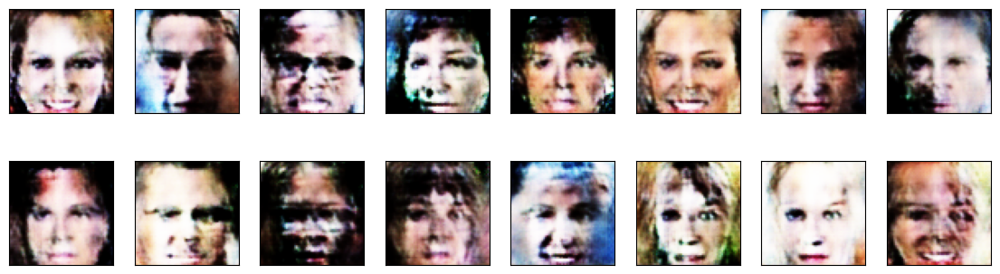

2024-01-20 14:20:16 | Epoch [5/50] | Batch 0/509 | d_loss: 0.6522 | g_loss: 2.3612
2024-01-20 14:20:18 | Epoch [5/50] | Batch 50/509 | d_loss: 0.1924 | g_loss: 3.4338
2024-01-20 14:20:21 | Epoch [5/50] | Batch 100/509 | d_loss: 0.1893 | g_loss: 3.3817
2024-01-20 14:20:24 | Epoch [5/50] | Batch 150/509 | d_loss: 0.4325 | g_loss: 3.5913
2024-01-20 14:20:27 | Epoch [5/50] | Batch 200/509 | d_loss: 1.2182 | g_loss: 8.4787
2024-01-20 14:20:30 | Epoch [5/50] | Batch 250/509 | d_loss: 0.4505 | g_loss: 4.8088
2024-01-20 14:20:33 | Epoch [5/50] | Batch 300/509 | d_loss: 0.7152 | g_loss: 5.3643
2024-01-20 14:20:36 | Epoch [5/50] | Batch 350/509 | d_loss: 1.6579 | g_loss: 5.9768
2024-01-20 14:20:39 | Epoch [5/50] | Batch 400/509 | d_loss: 0.2733 | g_loss: 6.5943
2024-01-20 14:20:42 | Epoch [5/50] | Batch 450/509 | d_loss: 0.1087 | g_loss: 2.5482
2024-01-20 14:20:45 | Epoch [5/50] | Batch 500/509 | d_loss: 0.4355 | g_loss: 2.9809


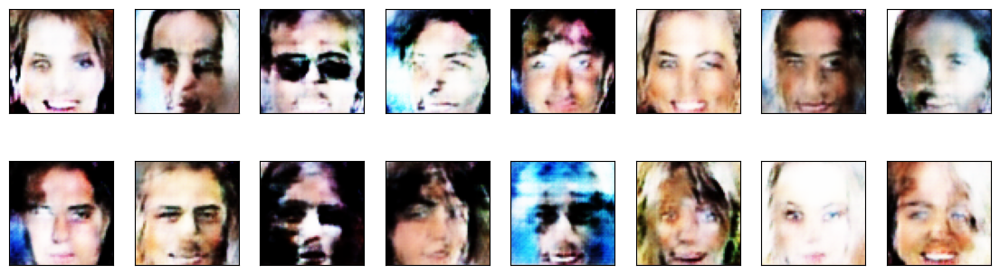

2024-01-20 14:20:46 | Epoch [6/50] | Batch 0/509 | d_loss: 0.0623 | g_loss: 3.9969
2024-01-20 14:20:49 | Epoch [6/50] | Batch 50/509 | d_loss: 0.4486 | g_loss: 3.6512
2024-01-20 14:20:52 | Epoch [6/50] | Batch 100/509 | d_loss: 0.1027 | g_loss: 3.8126
2024-01-20 14:20:55 | Epoch [6/50] | Batch 150/509 | d_loss: 1.2199 | g_loss: 5.7613
2024-01-20 14:20:58 | Epoch [6/50] | Batch 200/509 | d_loss: 0.2312 | g_loss: 2.8126
2024-01-20 14:21:00 | Epoch [6/50] | Batch 250/509 | d_loss: 0.3516 | g_loss: 3.2902
2024-01-20 14:21:03 | Epoch [6/50] | Batch 300/509 | d_loss: 0.6711 | g_loss: 6.3506
2024-01-20 14:21:06 | Epoch [6/50] | Batch 350/509 | d_loss: 0.2072 | g_loss: 3.2661
2024-01-20 14:21:09 | Epoch [6/50] | Batch 400/509 | d_loss: 0.0903 | g_loss: 5.0024
2024-01-20 14:21:12 | Epoch [6/50] | Batch 450/509 | d_loss: 0.3092 | g_loss: 3.8849
2024-01-20 14:21:15 | Epoch [6/50] | Batch 500/509 | d_loss: 0.0775 | g_loss: 3.5388


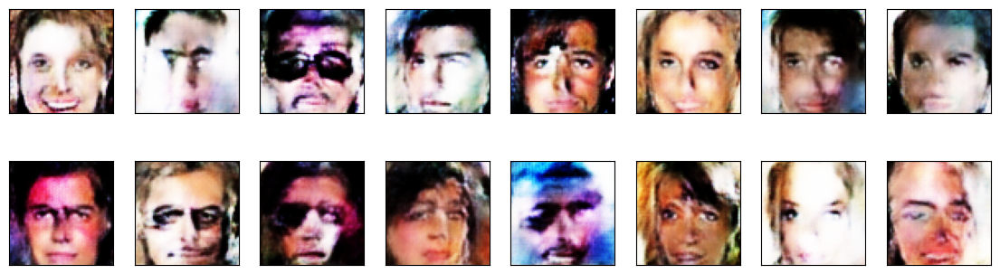

2024-01-20 14:21:16 | Epoch [7/50] | Batch 0/509 | d_loss: 0.2551 | g_loss: 6.0361
2024-01-20 14:21:19 | Epoch [7/50] | Batch 50/509 | d_loss: 0.4212 | g_loss: 4.1919
2024-01-20 14:21:22 | Epoch [7/50] | Batch 100/509 | d_loss: 0.9646 | g_loss: 7.5166
2024-01-20 14:21:25 | Epoch [7/50] | Batch 150/509 | d_loss: 0.4045 | g_loss: 4.9847
2024-01-20 14:21:28 | Epoch [7/50] | Batch 200/509 | d_loss: 0.1459 | g_loss: 3.7841
2024-01-20 14:21:31 | Epoch [7/50] | Batch 250/509 | d_loss: 0.1109 | g_loss: 4.4723
2024-01-20 14:21:34 | Epoch [7/50] | Batch 300/509 | d_loss: 0.3257 | g_loss: 3.0636
2024-01-20 14:21:37 | Epoch [7/50] | Batch 350/509 | d_loss: 0.1278 | g_loss: 2.9448
2024-01-20 14:21:40 | Epoch [7/50] | Batch 400/509 | d_loss: 0.0816 | g_loss: 2.9285
2024-01-20 14:21:43 | Epoch [7/50] | Batch 450/509 | d_loss: 0.4318 | g_loss: 4.7770
2024-01-20 14:21:46 | Epoch [7/50] | Batch 500/509 | d_loss: 1.6682 | g_loss: 4.6619


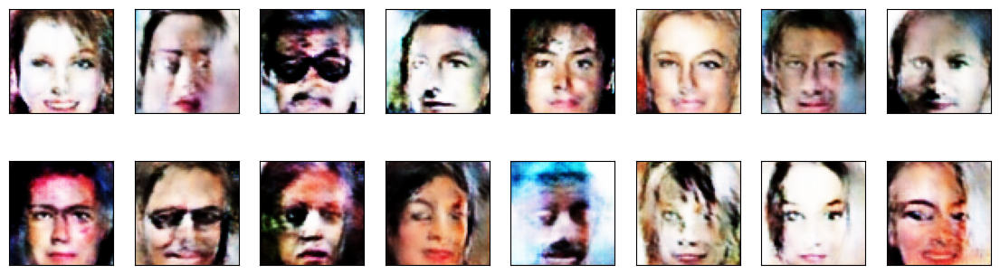

2024-01-20 14:21:47 | Epoch [8/50] | Batch 0/509 | d_loss: 0.3510 | g_loss: 2.2053
2024-01-20 14:21:50 | Epoch [8/50] | Batch 50/509 | d_loss: 0.0638 | g_loss: 2.7648
2024-01-20 14:21:53 | Epoch [8/50] | Batch 100/509 | d_loss: 0.0737 | g_loss: 5.5640
2024-01-20 14:21:56 | Epoch [8/50] | Batch 150/509 | d_loss: 0.0755 | g_loss: 4.9199
2024-01-20 14:21:58 | Epoch [8/50] | Batch 200/509 | d_loss: 0.0716 | g_loss: 4.0964
2024-01-20 14:22:01 | Epoch [8/50] | Batch 250/509 | d_loss: 0.0625 | g_loss: 3.4282
2024-01-20 14:22:04 | Epoch [8/50] | Batch 300/509 | d_loss: 0.0314 | g_loss: 5.0178
2024-01-20 14:22:07 | Epoch [8/50] | Batch 350/509 | d_loss: 0.1740 | g_loss: 3.5832
2024-01-20 14:22:10 | Epoch [8/50] | Batch 400/509 | d_loss: 0.0538 | g_loss: 5.0561
2024-01-20 14:22:13 | Epoch [8/50] | Batch 450/509 | d_loss: 0.5046 | g_loss: 5.9641
2024-01-20 14:22:16 | Epoch [8/50] | Batch 500/509 | d_loss: 0.6210 | g_loss: 2.1216


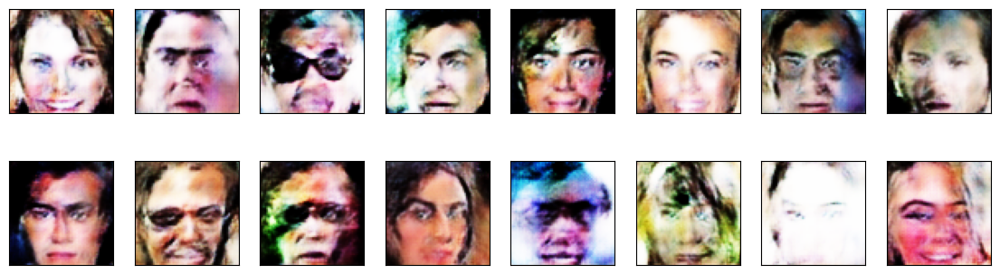

2024-01-20 14:22:17 | Epoch [9/50] | Batch 0/509 | d_loss: 0.3882 | g_loss: 3.6484
2024-01-20 14:22:20 | Epoch [9/50] | Batch 50/509 | d_loss: 0.4515 | g_loss: 2.9533
2024-01-20 14:22:23 | Epoch [9/50] | Batch 100/509 | d_loss: 0.1487 | g_loss: 4.8678
2024-01-20 14:22:26 | Epoch [9/50] | Batch 150/509 | d_loss: 0.0862 | g_loss: 3.7470
2024-01-20 14:22:29 | Epoch [9/50] | Batch 200/509 | d_loss: 1.1076 | g_loss: 8.9565
2024-01-20 14:22:32 | Epoch [9/50] | Batch 250/509 | d_loss: 0.0720 | g_loss: 4.7532
2024-01-20 14:22:35 | Epoch [9/50] | Batch 300/509 | d_loss: 0.6038 | g_loss: 7.6481
2024-01-20 14:22:38 | Epoch [9/50] | Batch 350/509 | d_loss: 0.1848 | g_loss: 7.0429
2024-01-20 14:22:41 | Epoch [9/50] | Batch 400/509 | d_loss: 0.1545 | g_loss: 5.5885
2024-01-20 14:22:43 | Epoch [9/50] | Batch 450/509 | d_loss: 0.1892 | g_loss: 1.8632
2024-01-20 14:22:46 | Epoch [9/50] | Batch 500/509 | d_loss: 0.0567 | g_loss: 5.5253


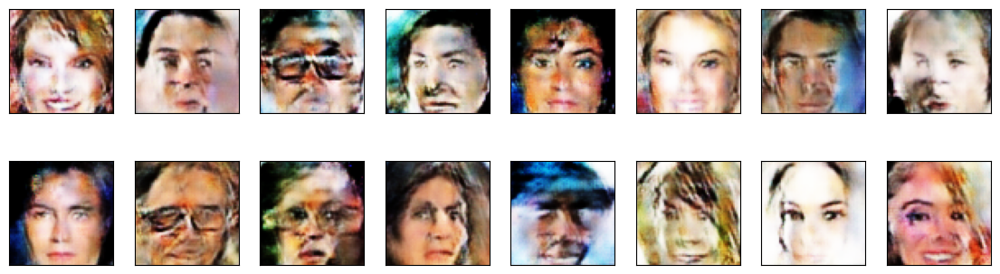

2024-01-20 14:22:48 | Epoch [10/50] | Batch 0/509 | d_loss: 0.0560 | g_loss: 2.9687
2024-01-20 14:22:51 | Epoch [10/50] | Batch 50/509 | d_loss: 0.6152 | g_loss: 5.1434
2024-01-20 14:22:54 | Epoch [10/50] | Batch 100/509 | d_loss: 0.3575 | g_loss: 4.1465
2024-01-20 14:22:56 | Epoch [10/50] | Batch 150/509 | d_loss: 0.0822 | g_loss: 1.6572
2024-01-20 14:22:59 | Epoch [10/50] | Batch 200/509 | d_loss: 0.0364 | g_loss: 6.3065
2024-01-20 14:23:02 | Epoch [10/50] | Batch 250/509 | d_loss: 0.1852 | g_loss: 3.2211
2024-01-20 14:23:05 | Epoch [10/50] | Batch 300/509 | d_loss: 0.2241 | g_loss: 4.9838
2024-01-20 14:23:08 | Epoch [10/50] | Batch 350/509 | d_loss: 0.2345 | g_loss: 4.1199
2024-01-20 14:23:11 | Epoch [10/50] | Batch 400/509 | d_loss: 0.1305 | g_loss: 5.6682
2024-01-20 14:23:14 | Epoch [10/50] | Batch 450/509 | d_loss: 0.2451 | g_loss: 4.2750
2024-01-20 14:23:17 | Epoch [10/50] | Batch 500/509 | d_loss: 0.0551 | g_loss: 5.9351


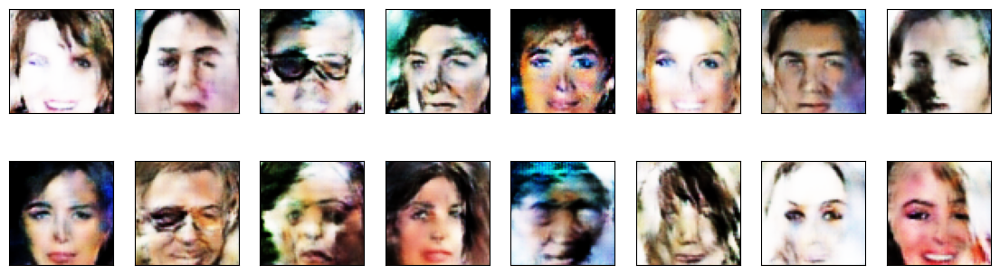

2024-01-20 14:23:18 | Epoch [11/50] | Batch 0/509 | d_loss: 0.0916 | g_loss: 4.6291
2024-01-20 14:23:21 | Epoch [11/50] | Batch 50/509 | d_loss: 0.2242 | g_loss: 4.0402
2024-01-20 14:23:24 | Epoch [11/50] | Batch 100/509 | d_loss: 0.1893 | g_loss: 2.2665
2024-01-20 14:23:27 | Epoch [11/50] | Batch 150/509 | d_loss: 0.1683 | g_loss: 3.6914
2024-01-20 14:23:30 | Epoch [11/50] | Batch 200/509 | d_loss: 0.2600 | g_loss: 5.4208
2024-01-20 14:23:33 | Epoch [11/50] | Batch 250/509 | d_loss: 0.1058 | g_loss: 4.1595
2024-01-20 14:23:36 | Epoch [11/50] | Batch 300/509 | d_loss: 0.0668 | g_loss: 5.2961
2024-01-20 14:23:39 | Epoch [11/50] | Batch 350/509 | d_loss: 0.1763 | g_loss: 5.1031
2024-01-20 14:23:41 | Epoch [11/50] | Batch 400/509 | d_loss: 0.1265 | g_loss: 3.7647
2024-01-20 14:23:44 | Epoch [11/50] | Batch 450/509 | d_loss: 0.0333 | g_loss: 4.5836
2024-01-20 14:23:47 | Epoch [11/50] | Batch 500/509 | d_loss: 0.4389 | g_loss: 6.8523


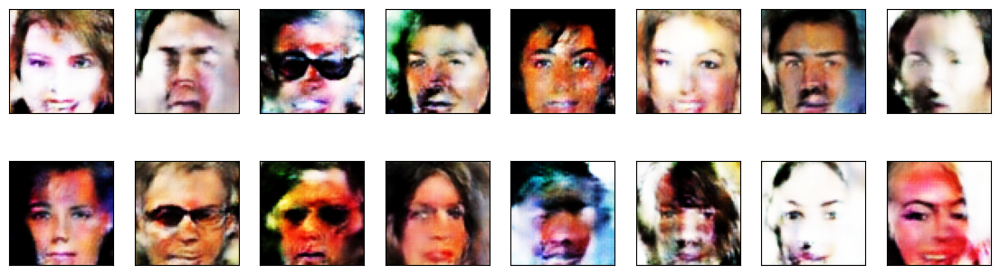

2024-01-20 14:23:49 | Epoch [12/50] | Batch 0/509 | d_loss: 0.0898 | g_loss: 4.3282
2024-01-20 14:23:52 | Epoch [12/50] | Batch 50/509 | d_loss: 0.4963 | g_loss: 2.3375
2024-01-20 14:23:54 | Epoch [12/50] | Batch 100/509 | d_loss: 0.6352 | g_loss: 7.8456
2024-01-20 14:23:57 | Epoch [12/50] | Batch 150/509 | d_loss: 0.0184 | g_loss: 8.0248
2024-01-20 14:24:00 | Epoch [12/50] | Batch 200/509 | d_loss: 0.1960 | g_loss: 4.7231
2024-01-20 14:24:03 | Epoch [12/50] | Batch 250/509 | d_loss: 0.1357 | g_loss: 4.8938
2024-01-20 14:24:06 | Epoch [12/50] | Batch 300/509 | d_loss: 0.8423 | g_loss: 5.3733
2024-01-20 14:24:09 | Epoch [12/50] | Batch 350/509 | d_loss: 0.1004 | g_loss: 5.0070
2024-01-20 14:24:12 | Epoch [12/50] | Batch 400/509 | d_loss: 0.5297 | g_loss: 8.2565
2024-01-20 14:24:15 | Epoch [12/50] | Batch 450/509 | d_loss: 0.0940 | g_loss: 3.0132
2024-01-20 14:24:18 | Epoch [12/50] | Batch 500/509 | d_loss: 2.5332 | g_loss: 4.9682


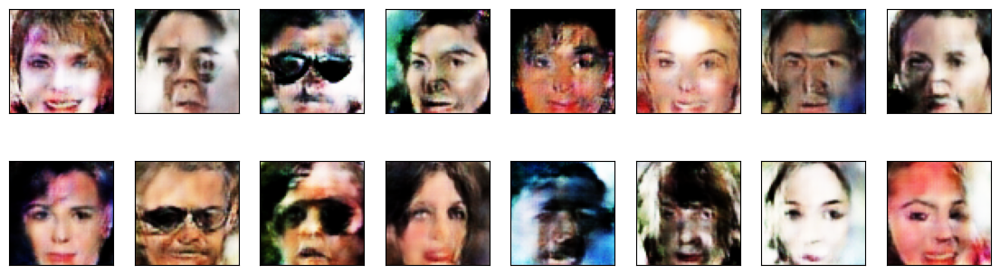

2024-01-20 14:24:19 | Epoch [13/50] | Batch 0/509 | d_loss: 0.3428 | g_loss: 2.9210
2024-01-20 14:24:22 | Epoch [13/50] | Batch 50/509 | d_loss: 0.3053 | g_loss: 6.1283
2024-01-20 14:24:25 | Epoch [13/50] | Batch 100/509 | d_loss: 0.0445 | g_loss: 2.8319
2024-01-20 14:24:28 | Epoch [13/50] | Batch 150/509 | d_loss: 0.1715 | g_loss: 3.2370
2024-01-20 14:24:31 | Epoch [13/50] | Batch 200/509 | d_loss: 0.2686 | g_loss: 6.9761
2024-01-20 14:24:34 | Epoch [13/50] | Batch 250/509 | d_loss: 0.1410 | g_loss: 5.2824
2024-01-20 14:24:37 | Epoch [13/50] | Batch 300/509 | d_loss: 0.0793 | g_loss: 4.5332
2024-01-20 14:24:39 | Epoch [13/50] | Batch 350/509 | d_loss: 0.0437 | g_loss: 4.2398
2024-01-20 14:24:42 | Epoch [13/50] | Batch 400/509 | d_loss: 0.1292 | g_loss: 5.9245
2024-01-20 14:24:45 | Epoch [13/50] | Batch 450/509 | d_loss: 0.2258 | g_loss: 4.8890
2024-01-20 14:24:48 | Epoch [13/50] | Batch 500/509 | d_loss: 0.0842 | g_loss: 4.2263


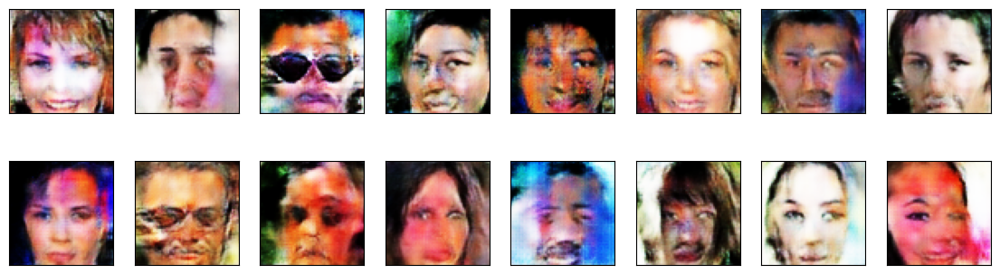

2024-01-20 14:24:49 | Epoch [14/50] | Batch 0/509 | d_loss: 0.0887 | g_loss: 4.3217
2024-01-20 14:24:52 | Epoch [14/50] | Batch 50/509 | d_loss: 0.1043 | g_loss: 5.7446
2024-01-20 14:24:55 | Epoch [14/50] | Batch 100/509 | d_loss: 0.0689 | g_loss: 4.1093
2024-01-20 14:24:58 | Epoch [14/50] | Batch 150/509 | d_loss: 0.0325 | g_loss: 1.4276
2024-01-20 14:25:01 | Epoch [14/50] | Batch 200/509 | d_loss: 0.1275 | g_loss: 3.9775
2024-01-20 14:25:04 | Epoch [14/50] | Batch 250/509 | d_loss: 0.0819 | g_loss: 5.5516
2024-01-20 14:25:07 | Epoch [14/50] | Batch 300/509 | d_loss: 3.0685 | g_loss: 5.2419
2024-01-20 14:25:10 | Epoch [14/50] | Batch 350/509 | d_loss: 0.0505 | g_loss: 3.0436
2024-01-20 14:25:13 | Epoch [14/50] | Batch 400/509 | d_loss: 0.0241 | g_loss: 5.2448
2024-01-20 14:25:16 | Epoch [14/50] | Batch 450/509 | d_loss: 0.0539 | g_loss: 5.5338
2024-01-20 14:25:19 | Epoch [14/50] | Batch 500/509 | d_loss: 0.2357 | g_loss: 5.7102


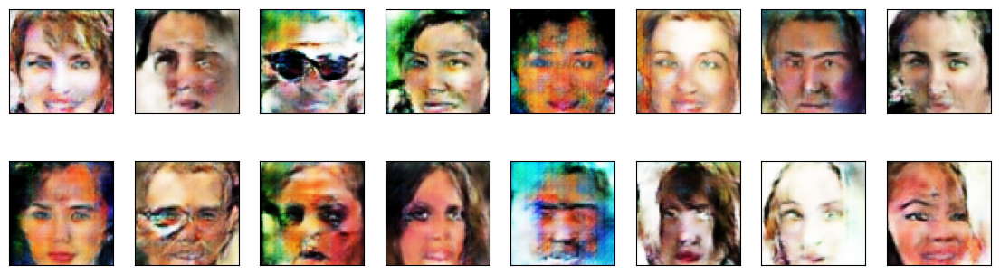

2024-01-20 14:25:20 | Epoch [15/50] | Batch 0/509 | d_loss: 0.0602 | g_loss: 3.2033
2024-01-20 14:25:23 | Epoch [15/50] | Batch 50/509 | d_loss: 0.0973 | g_loss: 3.4363
2024-01-20 14:25:26 | Epoch [15/50] | Batch 100/509 | d_loss: 0.2169 | g_loss: 1.9235
2024-01-20 14:25:29 | Epoch [15/50] | Batch 150/509 | d_loss: 0.0627 | g_loss: 5.8935
2024-01-20 14:25:32 | Epoch [15/50] | Batch 200/509 | d_loss: 0.9720 | g_loss: 2.4857
2024-01-20 14:25:35 | Epoch [15/50] | Batch 250/509 | d_loss: 0.6619 | g_loss: 3.8739
2024-01-20 14:25:38 | Epoch [15/50] | Batch 300/509 | d_loss: 0.1008 | g_loss: 6.5485
2024-01-20 14:25:40 | Epoch [15/50] | Batch 350/509 | d_loss: 0.1468 | g_loss: 4.2762
2024-01-20 14:25:43 | Epoch [15/50] | Batch 400/509 | d_loss: 0.2366 | g_loss: 2.1709
2024-01-20 14:25:46 | Epoch [15/50] | Batch 450/509 | d_loss: 0.0825 | g_loss: 6.6203
2024-01-20 14:25:49 | Epoch [15/50] | Batch 500/509 | d_loss: 1.0508 | g_loss: 9.4958


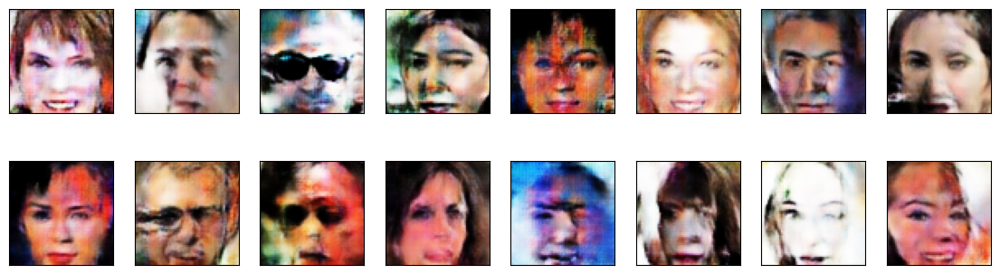

2024-01-20 14:25:50 | Epoch [16/50] | Batch 0/509 | d_loss: 0.3441 | g_loss: 5.2689
2024-01-20 14:25:53 | Epoch [16/50] | Batch 50/509 | d_loss: 0.1428 | g_loss: 4.5827
2024-01-20 14:25:56 | Epoch [16/50] | Batch 100/509 | d_loss: 0.1635 | g_loss: 4.6229
2024-01-20 14:25:59 | Epoch [16/50] | Batch 150/509 | d_loss: 0.3911 | g_loss: 6.0508
2024-01-20 14:26:02 | Epoch [16/50] | Batch 200/509 | d_loss: 0.0967 | g_loss: 5.4835
2024-01-20 14:26:05 | Epoch [16/50] | Batch 250/509 | d_loss: 0.0686 | g_loss: 4.1906
2024-01-20 14:26:08 | Epoch [16/50] | Batch 300/509 | d_loss: 0.2377 | g_loss: 3.5336
2024-01-20 14:26:11 | Epoch [16/50] | Batch 350/509 | d_loss: 0.0850 | g_loss: 4.4555
2024-01-20 14:26:14 | Epoch [16/50] | Batch 400/509 | d_loss: 0.1496 | g_loss: 3.8392
2024-01-20 14:26:17 | Epoch [16/50] | Batch 450/509 | d_loss: 0.1174 | g_loss: 5.4372
2024-01-20 14:26:20 | Epoch [16/50] | Batch 500/509 | d_loss: 0.0470 | g_loss: 4.4626


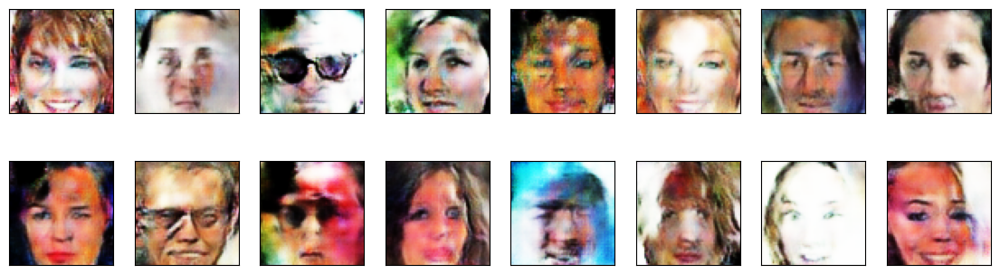

2024-01-20 14:26:21 | Epoch [17/50] | Batch 0/509 | d_loss: 0.0171 | g_loss: 4.2076
2024-01-20 14:26:24 | Epoch [17/50] | Batch 50/509 | d_loss: 0.4867 | g_loss: 4.5658
2024-01-20 14:26:27 | Epoch [17/50] | Batch 100/509 | d_loss: 0.0507 | g_loss: 4.1001
2024-01-20 14:26:30 | Epoch [17/50] | Batch 150/509 | d_loss: 1.9737 | g_loss: 1.3932
2024-01-20 14:26:33 | Epoch [17/50] | Batch 200/509 | d_loss: 0.2428 | g_loss: 3.9546
2024-01-20 14:26:36 | Epoch [17/50] | Batch 250/509 | d_loss: 0.2139 | g_loss: 5.9241
2024-01-20 14:26:38 | Epoch [17/50] | Batch 300/509 | d_loss: 0.1085 | g_loss: 5.2059
2024-01-20 14:26:41 | Epoch [17/50] | Batch 350/509 | d_loss: 0.0616 | g_loss: 6.8949
2024-01-20 14:26:44 | Epoch [17/50] | Batch 400/509 | d_loss: 0.0977 | g_loss: 6.3673
2024-01-20 14:26:47 | Epoch [17/50] | Batch 450/509 | d_loss: 0.5154 | g_loss: 2.2731
2024-01-20 14:26:50 | Epoch [17/50] | Batch 500/509 | d_loss: 0.1389 | g_loss: 2.6668


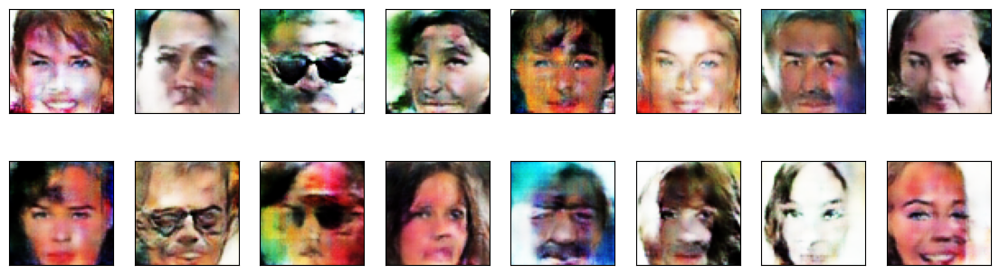

2024-01-20 14:26:51 | Epoch [18/50] | Batch 0/509 | d_loss: 0.1645 | g_loss: 2.6614
2024-01-20 14:26:54 | Epoch [18/50] | Batch 50/509 | d_loss: 0.0873 | g_loss: 7.0307
2024-01-20 14:26:57 | Epoch [18/50] | Batch 100/509 | d_loss: 0.0834 | g_loss: 4.2479
2024-01-20 14:27:00 | Epoch [18/50] | Batch 150/509 | d_loss: 0.2001 | g_loss: 2.8442
2024-01-20 14:27:03 | Epoch [18/50] | Batch 200/509 | d_loss: 0.0407 | g_loss: 5.7994
2024-01-20 14:27:06 | Epoch [18/50] | Batch 250/509 | d_loss: 0.1993 | g_loss: 3.7578
2024-01-20 14:27:09 | Epoch [18/50] | Batch 300/509 | d_loss: 0.1175 | g_loss: 3.7437
2024-01-20 14:27:12 | Epoch [18/50] | Batch 350/509 | d_loss: 0.0387 | g_loss: 6.0807
2024-01-20 14:27:15 | Epoch [18/50] | Batch 400/509 | d_loss: 0.0609 | g_loss: 2.8017
2024-01-20 14:27:18 | Epoch [18/50] | Batch 450/509 | d_loss: 0.0288 | g_loss: 4.9863
2024-01-20 14:27:21 | Epoch [18/50] | Batch 500/509 | d_loss: 0.0766 | g_loss: 5.4823


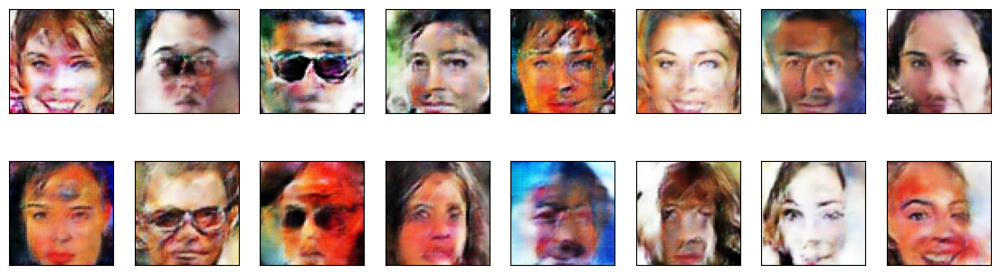

2024-01-20 14:27:22 | Epoch [19/50] | Batch 0/509 | d_loss: 0.0445 | g_loss: 3.0190
2024-01-20 14:27:25 | Epoch [19/50] | Batch 50/509 | d_loss: 0.2818 | g_loss: 4.2293
2024-01-20 14:27:28 | Epoch [19/50] | Batch 100/509 | d_loss: 0.1662 | g_loss: 5.2313
2024-01-20 14:27:31 | Epoch [19/50] | Batch 150/509 | d_loss: 0.0424 | g_loss: 3.4422
2024-01-20 14:27:34 | Epoch [19/50] | Batch 200/509 | d_loss: 0.7188 | g_loss: 1.8668
2024-01-20 14:27:37 | Epoch [19/50] | Batch 250/509 | d_loss: 0.2868 | g_loss: 2.1955
2024-01-20 14:27:39 | Epoch [19/50] | Batch 300/509 | d_loss: 0.0589 | g_loss: 3.3515
2024-01-20 14:27:42 | Epoch [19/50] | Batch 350/509 | d_loss: 0.0286 | g_loss: 5.6436
2024-01-20 14:27:45 | Epoch [19/50] | Batch 400/509 | d_loss: 0.0663 | g_loss: 3.6245
2024-01-20 14:27:48 | Epoch [19/50] | Batch 450/509 | d_loss: 0.2408 | g_loss: 3.3562
2024-01-20 14:27:51 | Epoch [19/50] | Batch 500/509 | d_loss: 0.0320 | g_loss: 3.6172


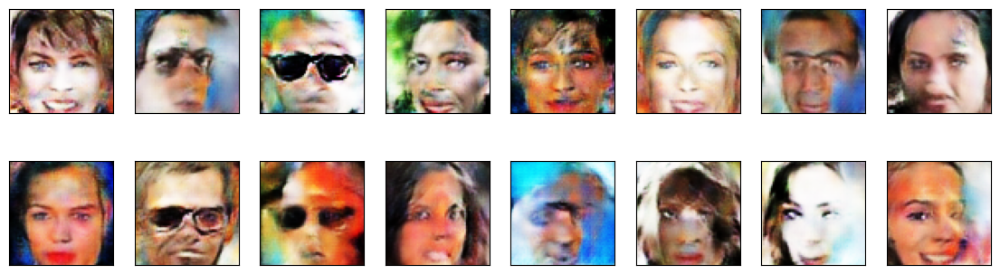

2024-01-20 14:27:52 | Epoch [20/50] | Batch 0/509 | d_loss: 0.0172 | g_loss: 6.2600
2024-01-20 14:27:55 | Epoch [20/50] | Batch 50/509 | d_loss: 0.6137 | g_loss: 4.3025
2024-01-20 14:27:58 | Epoch [20/50] | Batch 100/509 | d_loss: 0.1037 | g_loss: 2.4500
2024-01-20 14:28:01 | Epoch [20/50] | Batch 150/509 | d_loss: 0.1296 | g_loss: 5.7411
2024-01-20 14:28:04 | Epoch [20/50] | Batch 200/509 | d_loss: 0.1965 | g_loss: 3.8606
2024-01-20 14:28:07 | Epoch [20/50] | Batch 250/509 | d_loss: 0.0390 | g_loss: 5.6556
2024-01-20 14:28:10 | Epoch [20/50] | Batch 300/509 | d_loss: 0.1222 | g_loss: 6.8659
2024-01-20 14:28:13 | Epoch [20/50] | Batch 350/509 | d_loss: 0.6618 | g_loss: 6.0568
2024-01-20 14:28:16 | Epoch [20/50] | Batch 400/509 | d_loss: 0.1587 | g_loss: 4.0062
2024-01-20 14:28:19 | Epoch [20/50] | Batch 450/509 | d_loss: 0.0437 | g_loss: 3.8021
2024-01-20 14:28:22 | Epoch [20/50] | Batch 500/509 | d_loss: 0.0248 | g_loss: 4.2897


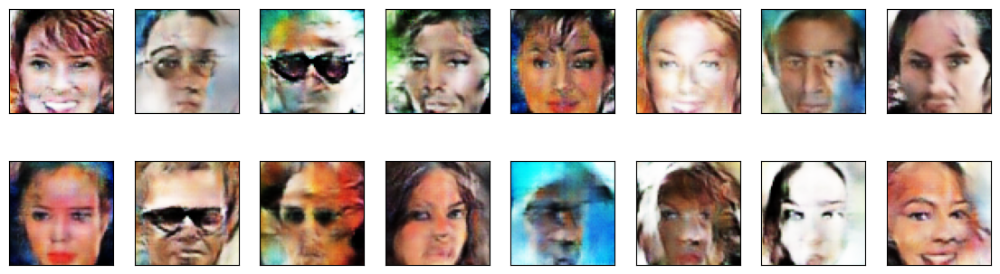

2024-01-20 14:28:23 | Epoch [21/50] | Batch 0/509 | d_loss: 0.0708 | g_loss: 5.8737
2024-01-20 14:28:26 | Epoch [21/50] | Batch 50/509 | d_loss: 0.0679 | g_loss: 3.0795
2024-01-20 14:28:29 | Epoch [21/50] | Batch 100/509 | d_loss: 0.0272 | g_loss: 5.7531
2024-01-20 14:28:32 | Epoch [21/50] | Batch 150/509 | d_loss: 0.5977 | g_loss: 5.0247
2024-01-20 14:28:35 | Epoch [21/50] | Batch 200/509 | d_loss: 0.0665 | g_loss: 6.6367
2024-01-20 14:28:37 | Epoch [21/50] | Batch 250/509 | d_loss: 0.0496 | g_loss: 5.0965
2024-01-20 14:28:40 | Epoch [21/50] | Batch 300/509 | d_loss: 0.0122 | g_loss: 6.5438
2024-01-20 14:28:43 | Epoch [21/50] | Batch 350/509 | d_loss: 0.3582 | g_loss: 3.0677
2024-01-20 14:28:46 | Epoch [21/50] | Batch 400/509 | d_loss: 0.1202 | g_loss: 2.5051
2024-01-20 14:28:49 | Epoch [21/50] | Batch 450/509 | d_loss: 0.3173 | g_loss: 2.7376
2024-01-20 14:28:52 | Epoch [21/50] | Batch 500/509 | d_loss: 0.0785 | g_loss: 2.7429


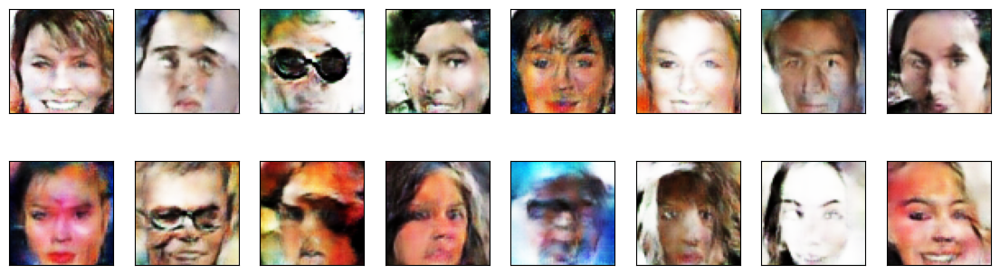

2024-01-20 14:28:53 | Epoch [22/50] | Batch 0/509 | d_loss: 0.9650 | g_loss: 9.5236
2024-01-20 14:28:56 | Epoch [22/50] | Batch 50/509 | d_loss: 0.0384 | g_loss: 4.1353
2024-01-20 14:28:59 | Epoch [22/50] | Batch 100/509 | d_loss: 0.0651 | g_loss: 3.1861
2024-01-20 14:29:02 | Epoch [22/50] | Batch 150/509 | d_loss: 0.2173 | g_loss: 5.2384
2024-01-20 14:29:05 | Epoch [22/50] | Batch 200/509 | d_loss: 0.3505 | g_loss: 2.7522
2024-01-20 14:29:08 | Epoch [22/50] | Batch 250/509 | d_loss: 0.3417 | g_loss: 3.4720
2024-01-20 14:29:11 | Epoch [22/50] | Batch 300/509 | d_loss: 0.2111 | g_loss: 6.3300
2024-01-20 14:29:14 | Epoch [22/50] | Batch 350/509 | d_loss: 0.2230 | g_loss: 2.1489
2024-01-20 14:29:17 | Epoch [22/50] | Batch 400/509 | d_loss: 0.2650 | g_loss: 4.6009
2024-01-20 14:29:20 | Epoch [22/50] | Batch 450/509 | d_loss: 0.1246 | g_loss: 3.6758
2024-01-20 14:29:23 | Epoch [22/50] | Batch 500/509 | d_loss: 0.3554 | g_loss: 4.5525


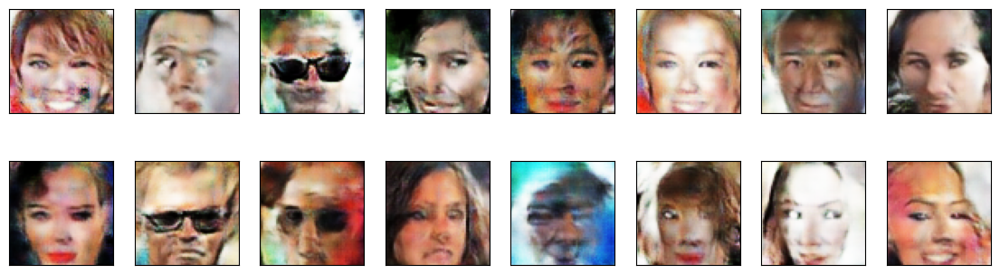

2024-01-20 14:29:24 | Epoch [23/50] | Batch 0/509 | d_loss: 0.3284 | g_loss: 6.0445
2024-01-20 14:29:27 | Epoch [23/50] | Batch 50/509 | d_loss: 0.0618 | g_loss: 3.1551
2024-01-20 14:29:30 | Epoch [23/50] | Batch 100/509 | d_loss: 0.1226 | g_loss: 4.6962
2024-01-20 14:29:33 | Epoch [23/50] | Batch 150/509 | d_loss: 0.3847 | g_loss: 5.0439
2024-01-20 14:29:36 | Epoch [23/50] | Batch 200/509 | d_loss: 0.5024 | g_loss: 3.0675
2024-01-20 14:29:39 | Epoch [23/50] | Batch 250/509 | d_loss: 0.2625 | g_loss: 2.1954
2024-01-20 14:29:42 | Epoch [23/50] | Batch 300/509 | d_loss: 0.1305 | g_loss: 3.0684
2024-01-20 14:29:45 | Epoch [23/50] | Batch 350/509 | d_loss: 0.3051 | g_loss: 5.0419
2024-01-20 14:29:47 | Epoch [23/50] | Batch 400/509 | d_loss: 0.2485 | g_loss: 1.6209
2024-01-20 14:29:50 | Epoch [23/50] | Batch 450/509 | d_loss: 0.2269 | g_loss: 4.0583
2024-01-20 14:29:53 | Epoch [23/50] | Batch 500/509 | d_loss: 0.4436 | g_loss: 7.1200


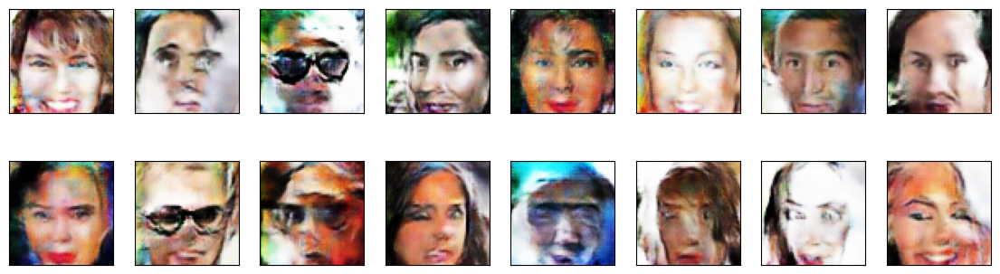

2024-01-20 14:29:55 | Epoch [24/50] | Batch 0/509 | d_loss: 2.6781 | g_loss: 9.3519
2024-01-20 14:29:57 | Epoch [24/50] | Batch 50/509 | d_loss: 0.0747 | g_loss: 4.3550
2024-01-20 14:30:00 | Epoch [24/50] | Batch 100/509 | d_loss: 0.0560 | g_loss: 4.4717
2024-01-20 14:30:03 | Epoch [24/50] | Batch 150/509 | d_loss: 0.3489 | g_loss: 5.1311
2024-01-20 14:30:06 | Epoch [24/50] | Batch 200/509 | d_loss: 0.0581 | g_loss: 5.4966
2024-01-20 14:30:09 | Epoch [24/50] | Batch 250/509 | d_loss: 0.0761 | g_loss: 4.9060
2024-01-20 14:30:12 | Epoch [24/50] | Batch 300/509 | d_loss: 0.0285 | g_loss: 7.1475
2024-01-20 14:30:15 | Epoch [24/50] | Batch 350/509 | d_loss: 0.0219 | g_loss: 3.3266
2024-01-20 14:30:18 | Epoch [24/50] | Batch 400/509 | d_loss: 0.0309 | g_loss: 4.6182
2024-01-20 14:30:21 | Epoch [24/50] | Batch 450/509 | d_loss: 0.1105 | g_loss: 5.7190
2024-01-20 14:30:24 | Epoch [24/50] | Batch 500/509 | d_loss: 0.2491 | g_loss: 5.2545


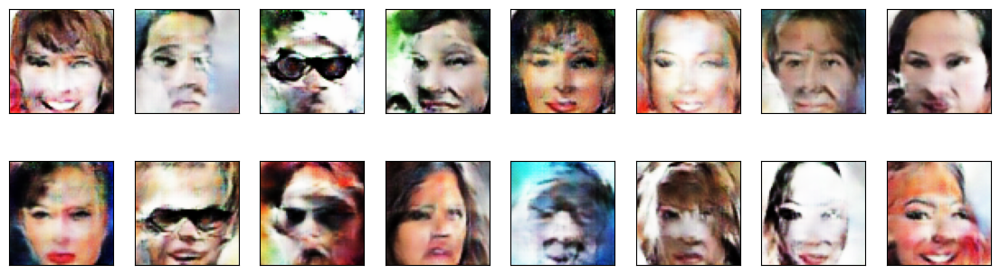

2024-01-20 14:30:25 | Epoch [25/50] | Batch 0/509 | d_loss: 1.0700 | g_loss: 3.1106
2024-01-20 14:30:28 | Epoch [25/50] | Batch 50/509 | d_loss: 0.1828 | g_loss: 2.8216
2024-01-20 14:30:31 | Epoch [25/50] | Batch 100/509 | d_loss: 0.2181 | g_loss: 5.1196
2024-01-20 14:30:34 | Epoch [25/50] | Batch 150/509 | d_loss: 0.0554 | g_loss: 5.7024
2024-01-20 14:30:37 | Epoch [25/50] | Batch 200/509 | d_loss: 0.1024 | g_loss: 5.2754
2024-01-20 14:30:40 | Epoch [25/50] | Batch 250/509 | d_loss: 0.2186 | g_loss: 3.1551
2024-01-20 14:30:43 | Epoch [25/50] | Batch 300/509 | d_loss: 0.0285 | g_loss: 1.8754
2024-01-20 14:30:45 | Epoch [25/50] | Batch 350/509 | d_loss: 0.0119 | g_loss: 1.2899
2024-01-20 14:30:48 | Epoch [25/50] | Batch 400/509 | d_loss: 0.2238 | g_loss: 5.8325
2024-01-20 14:30:51 | Epoch [25/50] | Batch 450/509 | d_loss: 0.0479 | g_loss: 3.8407
2024-01-20 14:30:54 | Epoch [25/50] | Batch 500/509 | d_loss: 0.0522 | g_loss: 4.3740


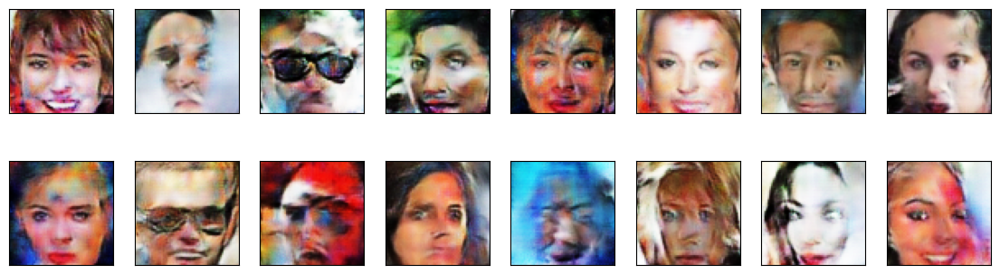

2024-01-20 14:30:56 | Epoch [26/50] | Batch 0/509 | d_loss: 0.0202 | g_loss: 3.8875
2024-01-20 14:30:58 | Epoch [26/50] | Batch 50/509 | d_loss: 0.0745 | g_loss: 1.4586
2024-01-20 14:31:01 | Epoch [26/50] | Batch 100/509 | d_loss: 1.9566 | g_loss: 0.2426
2024-01-20 14:31:04 | Epoch [26/50] | Batch 150/509 | d_loss: 0.1372 | g_loss: 3.5415
2024-01-20 14:31:07 | Epoch [26/50] | Batch 200/509 | d_loss: 0.0209 | g_loss: 5.2123
2024-01-20 14:31:10 | Epoch [26/50] | Batch 250/509 | d_loss: 0.0189 | g_loss: 5.5848
2024-01-20 14:31:13 | Epoch [26/50] | Batch 300/509 | d_loss: 0.6596 | g_loss: 2.6994
2024-01-20 14:31:16 | Epoch [26/50] | Batch 350/509 | d_loss: 0.1730 | g_loss: 3.4612
2024-01-20 14:31:19 | Epoch [26/50] | Batch 400/509 | d_loss: 0.4050 | g_loss: 3.9533
2024-01-20 14:31:22 | Epoch [26/50] | Batch 450/509 | d_loss: 0.0443 | g_loss: 7.8250
2024-01-20 14:31:25 | Epoch [26/50] | Batch 500/509 | d_loss: 0.0614 | g_loss: 5.7836


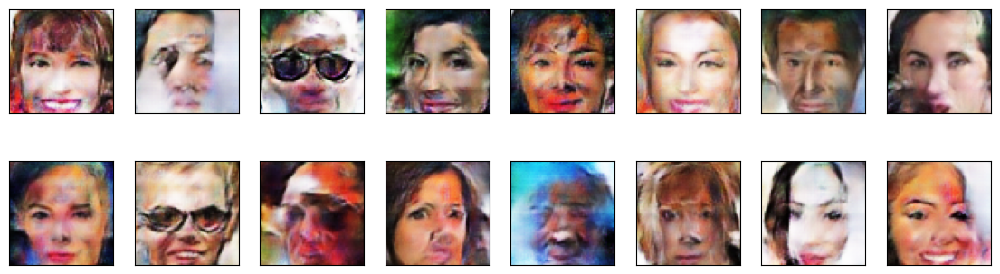

2024-01-20 14:31:26 | Epoch [27/50] | Batch 0/509 | d_loss: 0.0437 | g_loss: 6.9874
2024-01-20 14:31:29 | Epoch [27/50] | Batch 50/509 | d_loss: 0.6482 | g_loss: 4.4162
2024-01-20 14:31:32 | Epoch [27/50] | Batch 100/509 | d_loss: 4.9149 | g_loss: 3.3167
2024-01-20 14:31:35 | Epoch [27/50] | Batch 150/509 | d_loss: 0.1394 | g_loss: 5.1050
2024-01-20 14:31:38 | Epoch [27/50] | Batch 200/509 | d_loss: 0.0658 | g_loss: 3.8280
2024-01-20 14:31:41 | Epoch [27/50] | Batch 250/509 | d_loss: 0.2252 | g_loss: 1.6834
2024-01-20 14:31:43 | Epoch [27/50] | Batch 300/509 | d_loss: 0.0221 | g_loss: 3.8778
2024-01-20 14:31:46 | Epoch [27/50] | Batch 350/509 | d_loss: 0.0342 | g_loss: 2.4169
2024-01-20 14:31:49 | Epoch [27/50] | Batch 400/509 | d_loss: 0.0418 | g_loss: 3.1866
2024-01-20 14:31:52 | Epoch [27/50] | Batch 450/509 | d_loss: 0.2066 | g_loss: 2.7446
2024-01-20 14:31:55 | Epoch [27/50] | Batch 500/509 | d_loss: 0.8673 | g_loss: 12.1649


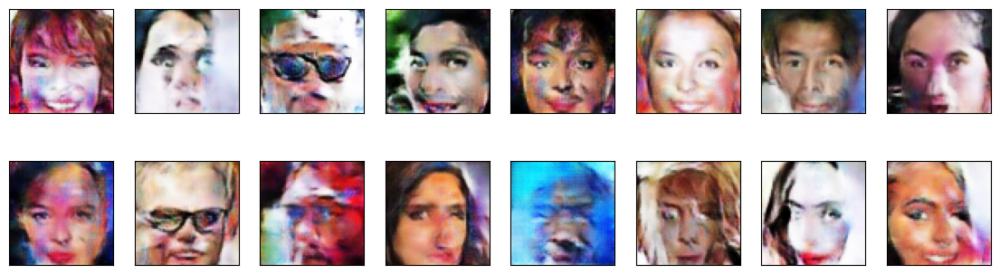

2024-01-20 14:31:56 | Epoch [28/50] | Batch 0/509 | d_loss: 0.1177 | g_loss: 3.4833
2024-01-20 14:31:59 | Epoch [28/50] | Batch 50/509 | d_loss: 0.0578 | g_loss: 3.9375
2024-01-20 14:32:02 | Epoch [28/50] | Batch 100/509 | d_loss: 0.0221 | g_loss: 5.6433
2024-01-20 14:32:05 | Epoch [28/50] | Batch 150/509 | d_loss: 0.2005 | g_loss: 3.9154
2024-01-20 14:32:08 | Epoch [28/50] | Batch 200/509 | d_loss: 0.0101 | g_loss: 4.5020
2024-01-20 14:32:11 | Epoch [28/50] | Batch 250/509 | d_loss: 0.3087 | g_loss: 5.0225
2024-01-20 14:32:14 | Epoch [28/50] | Batch 300/509 | d_loss: 0.0591 | g_loss: 3.9203
2024-01-20 14:32:17 | Epoch [28/50] | Batch 350/509 | d_loss: 0.0429 | g_loss: 5.2043
2024-01-20 14:32:20 | Epoch [28/50] | Batch 400/509 | d_loss: 0.0780 | g_loss: 4.1377
2024-01-20 14:32:23 | Epoch [28/50] | Batch 450/509 | d_loss: 0.2006 | g_loss: 4.1370
2024-01-20 14:32:26 | Epoch [28/50] | Batch 500/509 | d_loss: 0.3915 | g_loss: 3.6858


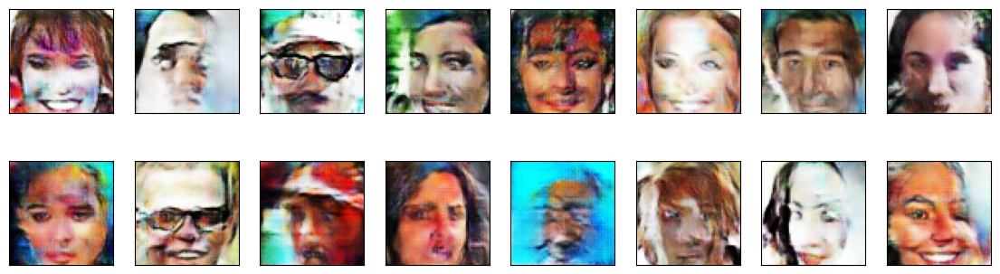

2024-01-20 14:32:27 | Epoch [29/50] | Batch 0/509 | d_loss: 0.3525 | g_loss: 4.2394
2024-01-20 14:32:30 | Epoch [29/50] | Batch 50/509 | d_loss: 0.0725 | g_loss: 4.4254
2024-01-20 14:32:33 | Epoch [29/50] | Batch 100/509 | d_loss: 0.0083 | g_loss: 3.2247
2024-01-20 14:32:36 | Epoch [29/50] | Batch 150/509 | d_loss: 0.3001 | g_loss: 3.8458
2024-01-20 14:32:39 | Epoch [29/50] | Batch 200/509 | d_loss: 0.1380 | g_loss: 4.4594
2024-01-20 14:32:41 | Epoch [29/50] | Batch 250/509 | d_loss: 0.1079 | g_loss: 3.6806
2024-01-20 14:32:44 | Epoch [29/50] | Batch 300/509 | d_loss: 0.1220 | g_loss: 4.3186
2024-01-20 14:32:47 | Epoch [29/50] | Batch 350/509 | d_loss: 0.2277 | g_loss: 3.4866
2024-01-20 14:32:50 | Epoch [29/50] | Batch 400/509 | d_loss: 0.0647 | g_loss: 3.6157
2024-01-20 14:32:53 | Epoch [29/50] | Batch 450/509 | d_loss: 0.2196 | g_loss: 5.4859
2024-01-20 14:32:56 | Epoch [29/50] | Batch 500/509 | d_loss: 0.2704 | g_loss: 1.4557


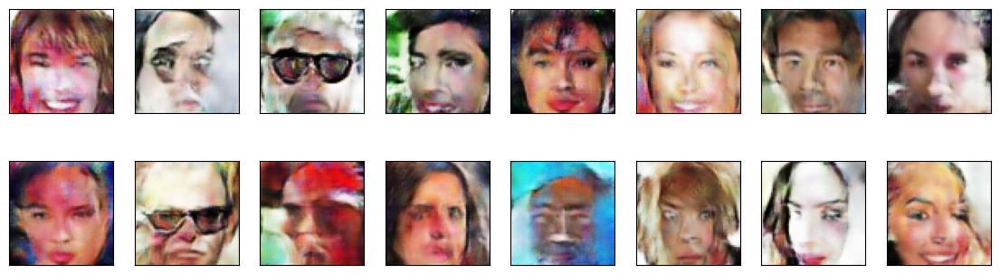

2024-01-20 14:32:57 | Epoch [30/50] | Batch 0/509 | d_loss: 0.0902 | g_loss: 3.8788
2024-01-20 14:33:00 | Epoch [30/50] | Batch 50/509 | d_loss: 0.0917 | g_loss: 4.3704
2024-01-20 14:33:03 | Epoch [30/50] | Batch 100/509 | d_loss: 0.2268 | g_loss: 2.8331
2024-01-20 14:33:06 | Epoch [30/50] | Batch 150/509 | d_loss: 0.0964 | g_loss: 5.0254
2024-01-20 14:33:09 | Epoch [30/50] | Batch 200/509 | d_loss: 0.0398 | g_loss: 5.1426
2024-01-20 14:33:12 | Epoch [30/50] | Batch 250/509 | d_loss: 0.6990 | g_loss: 7.6136
2024-01-20 14:33:15 | Epoch [30/50] | Batch 300/509 | d_loss: 0.0819 | g_loss: 4.6206
2024-01-20 14:33:18 | Epoch [30/50] | Batch 350/509 | d_loss: 0.1246 | g_loss: 4.1597
2024-01-20 14:33:21 | Epoch [30/50] | Batch 400/509 | d_loss: 0.1141 | g_loss: 4.3328
2024-01-20 14:33:24 | Epoch [30/50] | Batch 450/509 | d_loss: 0.1393 | g_loss: 2.3071
2024-01-20 14:33:26 | Epoch [30/50] | Batch 500/509 | d_loss: 0.0714 | g_loss: 4.0391


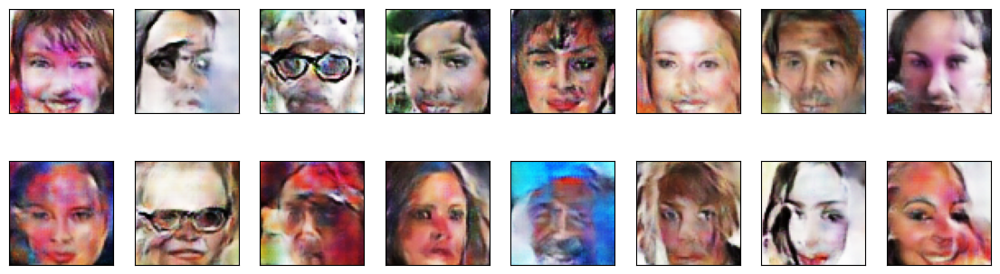

2024-01-20 14:33:28 | Epoch [31/50] | Batch 0/509 | d_loss: 0.1996 | g_loss: 2.9189
2024-01-20 14:33:31 | Epoch [31/50] | Batch 50/509 | d_loss: 0.0169 | g_loss: 4.2855
2024-01-20 14:33:34 | Epoch [31/50] | Batch 100/509 | d_loss: 0.0675 | g_loss: 4.9810
2024-01-20 14:33:37 | Epoch [31/50] | Batch 150/509 | d_loss: 0.0301 | g_loss: 4.4457
2024-01-20 14:33:40 | Epoch [31/50] | Batch 200/509 | d_loss: 0.1210 | g_loss: 5.2815
2024-01-20 14:33:42 | Epoch [31/50] | Batch 250/509 | d_loss: 0.2083 | g_loss: 6.4452
2024-01-20 14:33:45 | Epoch [31/50] | Batch 300/509 | d_loss: 0.2295 | g_loss: 5.3398
2024-01-20 14:33:48 | Epoch [31/50] | Batch 350/509 | d_loss: 0.4466 | g_loss: 5.2868
2024-01-20 14:33:51 | Epoch [31/50] | Batch 400/509 | d_loss: 0.0949 | g_loss: 4.8512
2024-01-20 14:33:54 | Epoch [31/50] | Batch 450/509 | d_loss: 0.0385 | g_loss: 8.1480
2024-01-20 14:33:57 | Epoch [31/50] | Batch 500/509 | d_loss: 0.0085 | g_loss: 5.2874


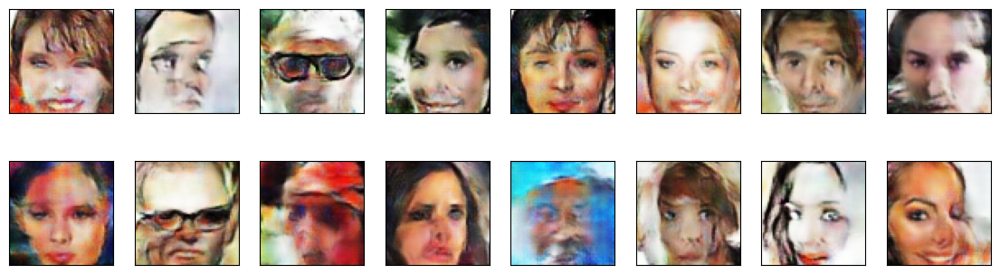

2024-01-20 14:33:58 | Epoch [32/50] | Batch 0/509 | d_loss: 0.0329 | g_loss: 4.8587
2024-01-20 14:34:01 | Epoch [32/50] | Batch 50/509 | d_loss: 0.2600 | g_loss: 4.4736
2024-01-20 14:34:04 | Epoch [32/50] | Batch 100/509 | d_loss: 0.0877 | g_loss: 5.0661
2024-01-20 14:34:07 | Epoch [32/50] | Batch 150/509 | d_loss: 0.0650 | g_loss: 4.6418
2024-01-20 14:34:10 | Epoch [32/50] | Batch 200/509 | d_loss: 0.0300 | g_loss: 6.0532
2024-01-20 14:34:13 | Epoch [32/50] | Batch 250/509 | d_loss: 0.0294 | g_loss: 8.8024
2024-01-20 14:34:16 | Epoch [32/50] | Batch 300/509 | d_loss: 0.1995 | g_loss: 4.9400
2024-01-20 14:34:19 | Epoch [32/50] | Batch 350/509 | d_loss: 0.4298 | g_loss: 5.8990
2024-01-20 14:34:22 | Epoch [32/50] | Batch 400/509 | d_loss: 0.5585 | g_loss: 6.6463
2024-01-20 14:34:25 | Epoch [32/50] | Batch 450/509 | d_loss: 0.1176 | g_loss: 7.7688
2024-01-20 14:34:27 | Epoch [32/50] | Batch 500/509 | d_loss: 0.0318 | g_loss: 5.1798


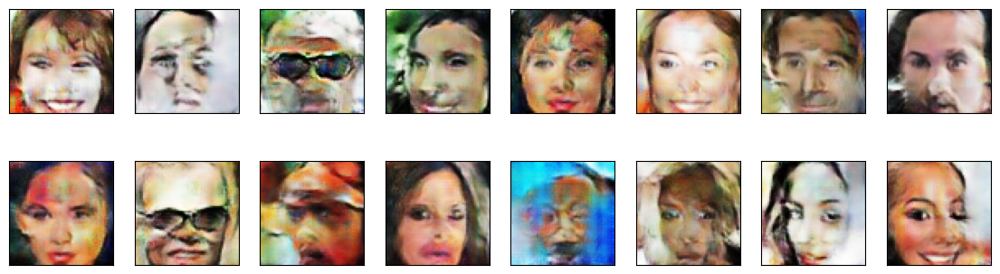

2024-01-20 14:34:29 | Epoch [33/50] | Batch 0/509 | d_loss: 0.0634 | g_loss: 11.1969
2024-01-20 14:34:32 | Epoch [33/50] | Batch 50/509 | d_loss: 0.0052 | g_loss: 5.9587
2024-01-20 14:34:35 | Epoch [33/50] | Batch 100/509 | d_loss: 0.4255 | g_loss: 4.1401
2024-01-20 14:34:37 | Epoch [33/50] | Batch 150/509 | d_loss: 0.1044 | g_loss: 2.7524
2024-01-20 14:34:40 | Epoch [33/50] | Batch 200/509 | d_loss: 0.1148 | g_loss: 4.3818
2024-01-20 14:34:43 | Epoch [33/50] | Batch 250/509 | d_loss: 0.0294 | g_loss: 4.2220
2024-01-20 14:34:46 | Epoch [33/50] | Batch 300/509 | d_loss: 0.1790 | g_loss: 3.9887
2024-01-20 14:34:49 | Epoch [33/50] | Batch 350/509 | d_loss: 0.0716 | g_loss: 2.7654
2024-01-20 14:34:52 | Epoch [33/50] | Batch 400/509 | d_loss: 0.9675 | g_loss: 9.5247
2024-01-20 14:34:55 | Epoch [33/50] | Batch 450/509 | d_loss: 0.1861 | g_loss: 2.9893
2024-01-20 14:34:58 | Epoch [33/50] | Batch 500/509 | d_loss: 0.8142 | g_loss: 4.7217


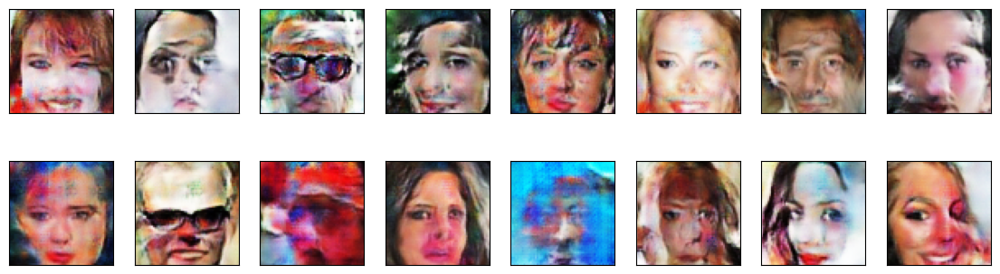

2024-01-20 14:34:59 | Epoch [34/50] | Batch 0/509 | d_loss: 0.2028 | g_loss: 3.0692
2024-01-20 14:35:02 | Epoch [34/50] | Batch 50/509 | d_loss: 0.0739 | g_loss: 4.4438
2024-01-20 14:35:05 | Epoch [34/50] | Batch 100/509 | d_loss: 2.7651 | g_loss: 0.4813
2024-01-20 14:35:08 | Epoch [34/50] | Batch 150/509 | d_loss: 0.1771 | g_loss: 2.2860
2024-01-20 14:35:11 | Epoch [34/50] | Batch 200/509 | d_loss: 0.0988 | g_loss: 4.3684
2024-01-20 14:35:14 | Epoch [34/50] | Batch 250/509 | d_loss: 0.0378 | g_loss: 6.5210
2024-01-20 14:35:17 | Epoch [34/50] | Batch 300/509 | d_loss: 0.3327 | g_loss: 4.1577
2024-01-20 14:35:20 | Epoch [34/50] | Batch 350/509 | d_loss: 0.2933 | g_loss: 2.8057
2024-01-20 14:35:23 | Epoch [34/50] | Batch 400/509 | d_loss: 0.1146 | g_loss: 4.1806
2024-01-20 14:35:26 | Epoch [34/50] | Batch 450/509 | d_loss: 0.0492 | g_loss: 3.7784
2024-01-20 14:35:28 | Epoch [34/50] | Batch 500/509 | d_loss: 0.0349 | g_loss: 3.4165


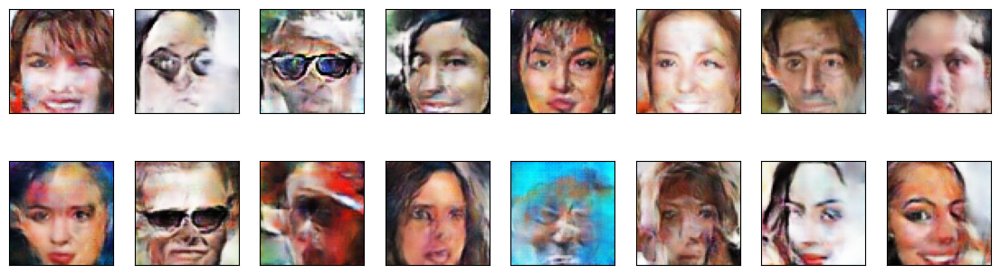

2024-01-20 14:35:30 | Epoch [35/50] | Batch 0/509 | d_loss: 0.1096 | g_loss: 3.8433
2024-01-20 14:35:33 | Epoch [35/50] | Batch 50/509 | d_loss: 0.0915 | g_loss: 4.9506
2024-01-20 14:35:36 | Epoch [35/50] | Batch 100/509 | d_loss: 0.0561 | g_loss: 6.8838
2024-01-20 14:35:38 | Epoch [35/50] | Batch 150/509 | d_loss: 0.0998 | g_loss: 5.9139
2024-01-20 14:35:41 | Epoch [35/50] | Batch 200/509 | d_loss: 0.0276 | g_loss: 6.3216
2024-01-20 14:35:44 | Epoch [35/50] | Batch 250/509 | d_loss: 0.0912 | g_loss: 5.6446
2024-01-20 14:35:47 | Epoch [35/50] | Batch 300/509 | d_loss: 0.0169 | g_loss: 4.9223
2024-01-20 14:35:50 | Epoch [35/50] | Batch 350/509 | d_loss: 0.0104 | g_loss: 6.8175
2024-01-20 14:35:53 | Epoch [35/50] | Batch 400/509 | d_loss: 0.2208 | g_loss: 4.0655
2024-01-20 14:35:56 | Epoch [35/50] | Batch 450/509 | d_loss: 0.0520 | g_loss: 4.6861
2024-01-20 14:35:59 | Epoch [35/50] | Batch 500/509 | d_loss: 0.0535 | g_loss: 2.6315


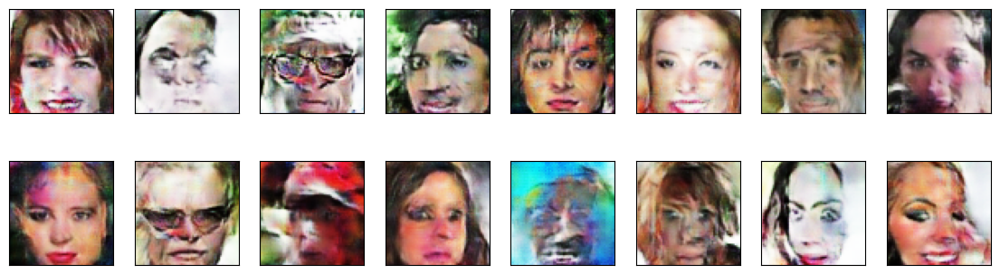

2024-01-20 14:36:00 | Epoch [36/50] | Batch 0/509 | d_loss: 0.0763 | g_loss: 4.9680
2024-01-20 14:36:03 | Epoch [36/50] | Batch 50/509 | d_loss: 0.0674 | g_loss: 5.7973
2024-01-20 14:36:06 | Epoch [36/50] | Batch 100/509 | d_loss: 0.3433 | g_loss: 4.9347
2024-01-20 14:36:09 | Epoch [36/50] | Batch 150/509 | d_loss: 0.1939 | g_loss: 4.4577
2024-01-20 14:36:12 | Epoch [36/50] | Batch 200/509 | d_loss: 0.1935 | g_loss: 3.8403
2024-01-20 14:36:15 | Epoch [36/50] | Batch 250/509 | d_loss: 0.2608 | g_loss: 5.6044
2024-01-20 14:36:18 | Epoch [36/50] | Batch 300/509 | d_loss: 0.0862 | g_loss: 5.0197
2024-01-20 14:36:21 | Epoch [36/50] | Batch 350/509 | d_loss: 0.0783 | g_loss: 5.8843
2024-01-20 14:36:24 | Epoch [36/50] | Batch 400/509 | d_loss: 0.0196 | g_loss: 3.4797
2024-01-20 14:36:26 | Epoch [36/50] | Batch 450/509 | d_loss: 0.8264 | g_loss: 10.6456
2024-01-20 14:36:29 | Epoch [36/50] | Batch 500/509 | d_loss: 0.1166 | g_loss: 5.8357


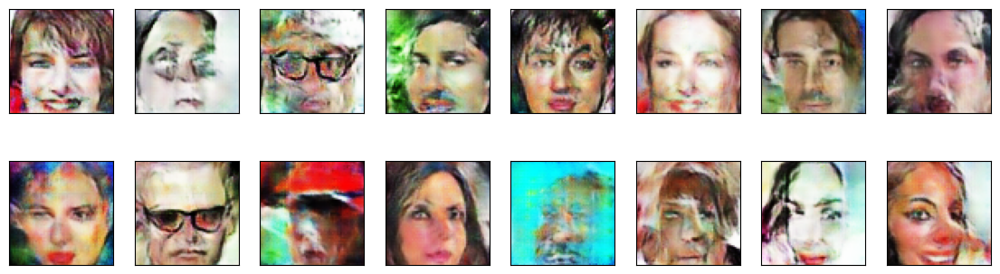

2024-01-20 14:36:31 | Epoch [37/50] | Batch 0/509 | d_loss: 0.1408 | g_loss: 5.1729
2024-01-20 14:36:34 | Epoch [37/50] | Batch 50/509 | d_loss: 0.0993 | g_loss: 2.9563
2024-01-20 14:36:37 | Epoch [37/50] | Batch 100/509 | d_loss: 0.0169 | g_loss: 4.2247
2024-01-20 14:36:39 | Epoch [37/50] | Batch 150/509 | d_loss: 0.0944 | g_loss: 5.0978
2024-01-20 14:36:42 | Epoch [37/50] | Batch 200/509 | d_loss: 0.0416 | g_loss: 4.8503
2024-01-20 14:36:45 | Epoch [37/50] | Batch 250/509 | d_loss: 0.0239 | g_loss: 6.1039
2024-01-20 14:36:48 | Epoch [37/50] | Batch 300/509 | d_loss: 0.0900 | g_loss: 6.6105
2024-01-20 14:36:51 | Epoch [37/50] | Batch 350/509 | d_loss: 0.0123 | g_loss: 3.2769
2024-01-20 14:36:54 | Epoch [37/50] | Batch 400/509 | d_loss: 0.0146 | g_loss: 5.5912
2024-01-20 14:36:57 | Epoch [37/50] | Batch 450/509 | d_loss: 0.6872 | g_loss: 4.2123
2024-01-20 14:37:00 | Epoch [37/50] | Batch 500/509 | d_loss: 0.4698 | g_loss: 4.7877


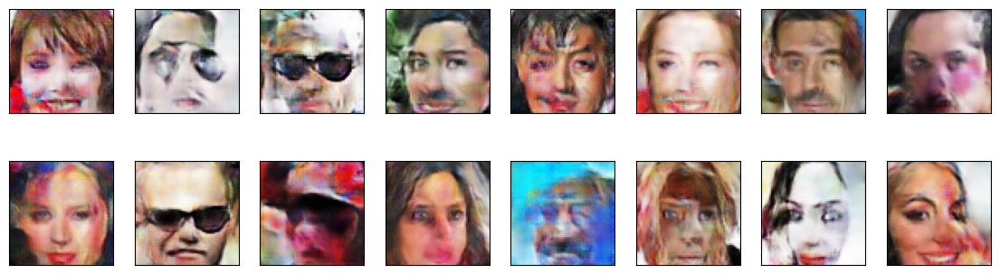

2024-01-20 14:37:01 | Epoch [38/50] | Batch 0/509 | d_loss: 0.2366 | g_loss: 5.3187
2024-01-20 14:37:04 | Epoch [38/50] | Batch 50/509 | d_loss: 1.4036 | g_loss: 5.7517
2024-01-20 14:37:07 | Epoch [38/50] | Batch 100/509 | d_loss: 0.0603 | g_loss: 5.6541
2024-01-20 14:37:10 | Epoch [38/50] | Batch 150/509 | d_loss: 0.2857 | g_loss: 7.0551
2024-01-20 14:37:13 | Epoch [38/50] | Batch 200/509 | d_loss: 0.7193 | g_loss: 8.2863
2024-01-20 14:37:16 | Epoch [38/50] | Batch 250/509 | d_loss: 0.0297 | g_loss: 2.1860
2024-01-20 14:37:19 | Epoch [38/50] | Batch 300/509 | d_loss: 0.6599 | g_loss: 6.5768
2024-01-20 14:37:22 | Epoch [38/50] | Batch 350/509 | d_loss: 0.1112 | g_loss: 5.9562
2024-01-20 14:37:24 | Epoch [38/50] | Batch 400/509 | d_loss: 0.0339 | g_loss: 4.9998
2024-01-20 14:37:27 | Epoch [38/50] | Batch 450/509 | d_loss: 0.0214 | g_loss: 4.5554
2024-01-20 14:37:30 | Epoch [38/50] | Batch 500/509 | d_loss: 0.1927 | g_loss: 4.6981


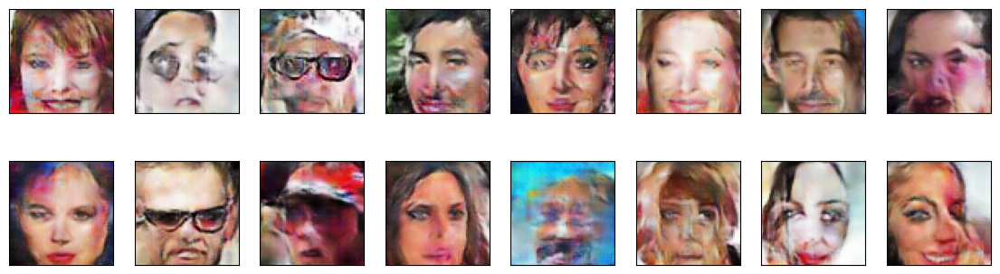

2024-01-20 14:37:32 | Epoch [39/50] | Batch 0/509 | d_loss: 0.1193 | g_loss: 4.1609
2024-01-20 14:37:35 | Epoch [39/50] | Batch 50/509 | d_loss: 0.1796 | g_loss: 5.9131
2024-01-20 14:37:38 | Epoch [39/50] | Batch 100/509 | d_loss: 0.0812 | g_loss: 2.7056
2024-01-20 14:37:40 | Epoch [39/50] | Batch 150/509 | d_loss: 0.0545 | g_loss: 5.1858
2024-01-20 14:37:43 | Epoch [39/50] | Batch 200/509 | d_loss: 0.0997 | g_loss: 5.2074
2024-01-20 14:37:46 | Epoch [39/50] | Batch 250/509 | d_loss: 0.0127 | g_loss: 6.4520
2024-01-20 14:37:49 | Epoch [39/50] | Batch 300/509 | d_loss: 0.6212 | g_loss: 3.3208
2024-01-20 14:37:52 | Epoch [39/50] | Batch 350/509 | d_loss: 1.5694 | g_loss: 6.0981
2024-01-20 14:37:55 | Epoch [39/50] | Batch 400/509 | d_loss: 0.1713 | g_loss: 2.3371
2024-01-20 14:37:58 | Epoch [39/50] | Batch 450/509 | d_loss: 0.1129 | g_loss: 3.9936
2024-01-20 14:38:01 | Epoch [39/50] | Batch 500/509 | d_loss: 0.1108 | g_loss: 6.2893


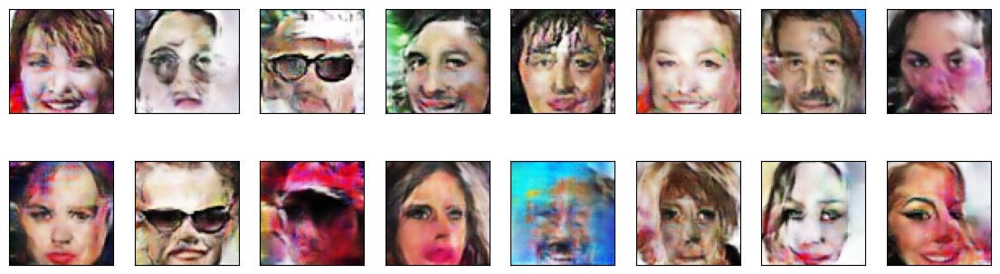

2024-01-20 14:38:02 | Epoch [40/50] | Batch 0/509 | d_loss: 0.0047 | g_loss: 6.0881
2024-01-20 14:38:05 | Epoch [40/50] | Batch 50/509 | d_loss: 0.0414 | g_loss: 8.3801
2024-01-20 14:38:08 | Epoch [40/50] | Batch 100/509 | d_loss: 0.0093 | g_loss: 5.5141
2024-01-20 14:38:11 | Epoch [40/50] | Batch 150/509 | d_loss: 0.0183 | g_loss: 5.5279
2024-01-20 14:38:14 | Epoch [40/50] | Batch 200/509 | d_loss: 0.0677 | g_loss: 3.3727
2024-01-20 14:38:17 | Epoch [40/50] | Batch 250/509 | d_loss: 0.1234 | g_loss: 4.9545
2024-01-20 14:38:20 | Epoch [40/50] | Batch 300/509 | d_loss: 0.0158 | g_loss: 5.5311
2024-01-20 14:38:23 | Epoch [40/50] | Batch 350/509 | d_loss: 0.1147 | g_loss: 6.9326
2024-01-20 14:38:25 | Epoch [40/50] | Batch 400/509 | d_loss: 0.0892 | g_loss: 2.7428
2024-01-20 14:38:28 | Epoch [40/50] | Batch 450/509 | d_loss: 0.4497 | g_loss: 4.4432
2024-01-20 14:38:31 | Epoch [40/50] | Batch 500/509 | d_loss: 0.0626 | g_loss: 5.2844


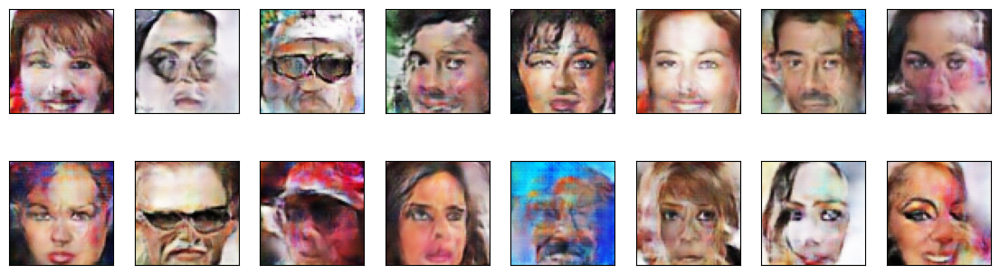

2024-01-20 14:38:33 | Epoch [41/50] | Batch 0/509 | d_loss: 0.6180 | g_loss: 7.7838
2024-01-20 14:38:36 | Epoch [41/50] | Batch 50/509 | d_loss: 0.0408 | g_loss: 4.0781
2024-01-20 14:38:38 | Epoch [41/50] | Batch 100/509 | d_loss: 0.0098 | g_loss: 5.1070
2024-01-20 14:38:41 | Epoch [41/50] | Batch 150/509 | d_loss: 0.0315 | g_loss: 5.6115
2024-01-20 14:38:44 | Epoch [41/50] | Batch 200/509 | d_loss: 0.0695 | g_loss: 4.6236
2024-01-20 14:38:47 | Epoch [41/50] | Batch 250/509 | d_loss: 0.0612 | g_loss: 4.0804
2024-01-20 14:38:50 | Epoch [41/50] | Batch 300/509 | d_loss: 0.5831 | g_loss: 2.8933
2024-01-20 14:38:53 | Epoch [41/50] | Batch 350/509 | d_loss: 0.1033 | g_loss: 4.4103
2024-01-20 14:38:56 | Epoch [41/50] | Batch 400/509 | d_loss: 0.4166 | g_loss: 3.1841
2024-01-20 14:38:59 | Epoch [41/50] | Batch 450/509 | d_loss: 0.0201 | g_loss: 5.9891
2024-01-20 14:39:02 | Epoch [41/50] | Batch 500/509 | d_loss: 0.0314 | g_loss: 3.1035


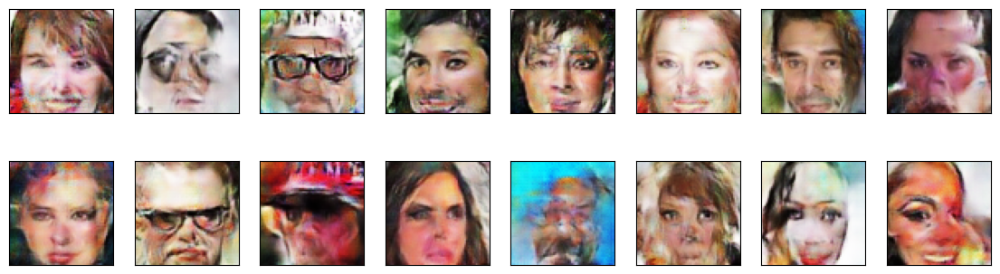

2024-01-20 14:39:03 | Epoch [42/50] | Batch 0/509 | d_loss: 0.1961 | g_loss: 7.9373
2024-01-20 14:39:06 | Epoch [42/50] | Batch 50/509 | d_loss: 0.0162 | g_loss: 5.6899
2024-01-20 14:39:09 | Epoch [42/50] | Batch 100/509 | d_loss: 0.0290 | g_loss: 3.9117
2024-01-20 14:39:12 | Epoch [42/50] | Batch 150/509 | d_loss: 0.4408 | g_loss: 3.8390
2024-01-20 14:39:15 | Epoch [42/50] | Batch 200/509 | d_loss: 0.1609 | g_loss: 5.0549
2024-01-20 14:39:18 | Epoch [42/50] | Batch 250/509 | d_loss: 0.7349 | g_loss: 8.3540
2024-01-20 14:39:21 | Epoch [42/50] | Batch 300/509 | d_loss: 0.1279 | g_loss: 6.2347
2024-01-20 14:39:24 | Epoch [42/50] | Batch 350/509 | d_loss: 0.2064 | g_loss: 5.0004
2024-01-20 14:39:26 | Epoch [42/50] | Batch 400/509 | d_loss: 0.2502 | g_loss: 5.0444
2024-01-20 14:39:29 | Epoch [42/50] | Batch 450/509 | d_loss: 0.0362 | g_loss: 5.6117
2024-01-20 14:39:32 | Epoch [42/50] | Batch 500/509 | d_loss: 0.1188 | g_loss: 4.4141


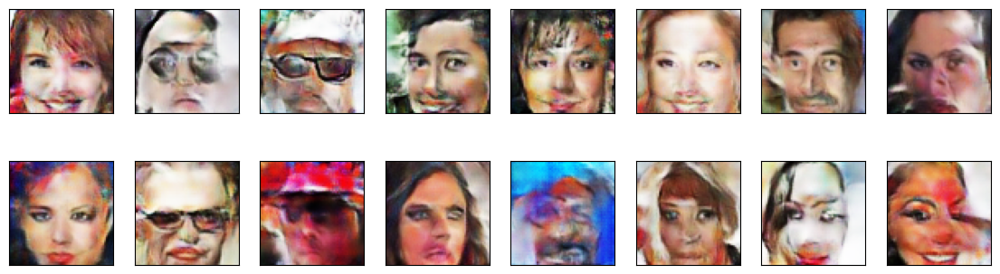

2024-01-20 14:39:34 | Epoch [43/50] | Batch 0/509 | d_loss: 0.0390 | g_loss: 3.3459
2024-01-20 14:39:36 | Epoch [43/50] | Batch 50/509 | d_loss: 0.4404 | g_loss: 1.4863
2024-01-20 14:39:39 | Epoch [43/50] | Batch 100/509 | d_loss: 0.0262 | g_loss: 3.3259
2024-01-20 14:39:42 | Epoch [43/50] | Batch 150/509 | d_loss: 0.0784 | g_loss: 2.0874
2024-01-20 14:39:45 | Epoch [43/50] | Batch 200/509 | d_loss: 0.2198 | g_loss: 5.3631
2024-01-20 14:39:48 | Epoch [43/50] | Batch 250/509 | d_loss: 0.2538 | g_loss: 2.8947
2024-01-20 14:39:51 | Epoch [43/50] | Batch 300/509 | d_loss: 0.1074 | g_loss: 4.1488
2024-01-20 14:39:54 | Epoch [43/50] | Batch 350/509 | d_loss: 0.5178 | g_loss: 2.8695
2024-01-20 14:39:57 | Epoch [43/50] | Batch 400/509 | d_loss: 0.1310 | g_loss: 5.1834
2024-01-20 14:40:00 | Epoch [43/50] | Batch 450/509 | d_loss: 0.2562 | g_loss: 2.6749
2024-01-20 14:40:03 | Epoch [43/50] | Batch 500/509 | d_loss: 0.0216 | g_loss: 7.9896


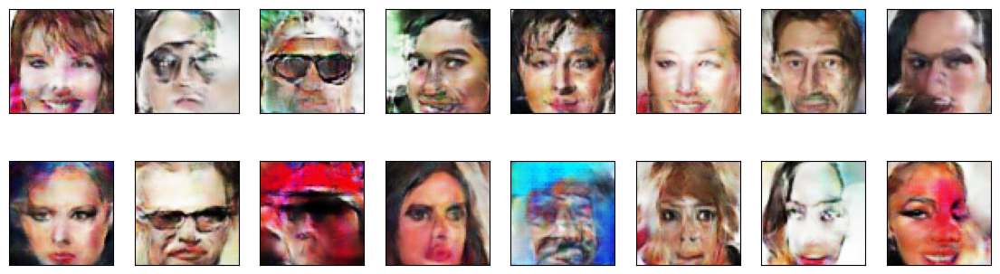

2024-01-20 14:40:04 | Epoch [44/50] | Batch 0/509 | d_loss: 0.3861 | g_loss: 6.9548
2024-01-20 14:40:07 | Epoch [44/50] | Batch 50/509 | d_loss: 0.0508 | g_loss: 6.0999
2024-01-20 14:40:10 | Epoch [44/50] | Batch 100/509 | d_loss: 0.1160 | g_loss: 3.1151
2024-01-20 14:40:13 | Epoch [44/50] | Batch 150/509 | d_loss: 0.0467 | g_loss: 5.1109
2024-01-20 14:40:16 | Epoch [44/50] | Batch 200/509 | d_loss: 0.0326 | g_loss: 4.6728
2024-01-20 14:40:19 | Epoch [44/50] | Batch 250/509 | d_loss: 0.6797 | g_loss: 8.8750
2024-01-20 14:40:21 | Epoch [44/50] | Batch 300/509 | d_loss: 0.1179 | g_loss: 4.2747
2024-01-20 14:40:24 | Epoch [44/50] | Batch 350/509 | d_loss: 0.1142 | g_loss: 10.7823
2024-01-20 14:40:27 | Epoch [44/50] | Batch 400/509 | d_loss: 0.0882 | g_loss: 6.2401
2024-01-20 14:40:30 | Epoch [44/50] | Batch 450/509 | d_loss: 0.0227 | g_loss: 6.9193
2024-01-20 14:40:33 | Epoch [44/50] | Batch 500/509 | d_loss: 0.0357 | g_loss: 7.4182


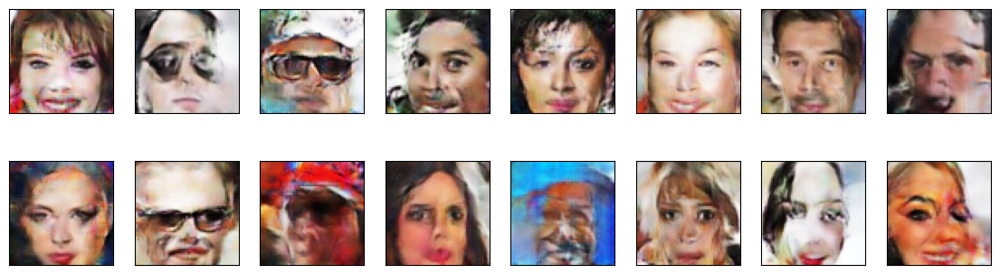

2024-01-20 14:40:34 | Epoch [45/50] | Batch 0/509 | d_loss: 0.0187 | g_loss: 4.6519
2024-01-20 14:40:37 | Epoch [45/50] | Batch 50/509 | d_loss: 0.1045 | g_loss: 6.5941
2024-01-20 14:40:40 | Epoch [45/50] | Batch 100/509 | d_loss: 0.0521 | g_loss: 6.1573
2024-01-20 14:40:43 | Epoch [45/50] | Batch 150/509 | d_loss: 0.1768 | g_loss: 8.5144
2024-01-20 14:40:46 | Epoch [45/50] | Batch 200/509 | d_loss: 0.0351 | g_loss: 3.7924
2024-01-20 14:40:49 | Epoch [45/50] | Batch 250/509 | d_loss: 0.1761 | g_loss: 3.7614
2024-01-20 14:40:52 | Epoch [45/50] | Batch 300/509 | d_loss: 0.1560 | g_loss: 3.9405
2024-01-20 14:40:55 | Epoch [45/50] | Batch 350/509 | d_loss: 0.5132 | g_loss: 7.9072
2024-01-20 14:40:58 | Epoch [45/50] | Batch 400/509 | d_loss: 0.1142 | g_loss: 3.6669
2024-01-20 14:41:01 | Epoch [45/50] | Batch 450/509 | d_loss: 0.0806 | g_loss: 2.8868
2024-01-20 14:41:04 | Epoch [45/50] | Batch 500/509 | d_loss: 0.3568 | g_loss: 5.4423


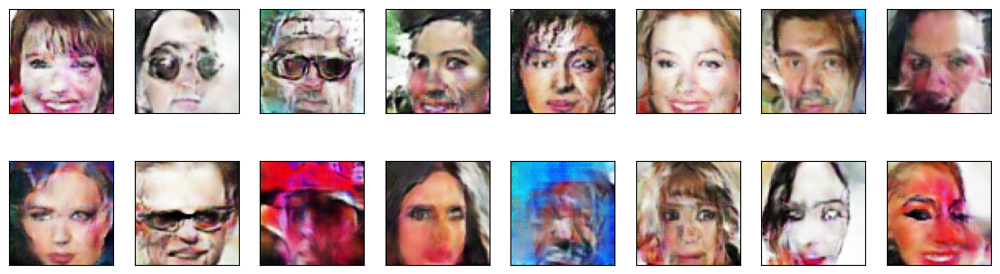

2024-01-20 14:41:05 | Epoch [46/50] | Batch 0/509 | d_loss: 0.0848 | g_loss: 4.3897
2024-01-20 14:41:08 | Epoch [46/50] | Batch 50/509 | d_loss: 0.0322 | g_loss: 3.4819
2024-01-20 14:41:11 | Epoch [46/50] | Batch 100/509 | d_loss: 0.0144 | g_loss: 6.0786
2024-01-20 14:41:14 | Epoch [46/50] | Batch 150/509 | d_loss: 0.1626 | g_loss: 5.6583
2024-01-20 14:41:17 | Epoch [46/50] | Batch 200/509 | d_loss: 0.0520 | g_loss: 5.5890
2024-01-20 14:41:19 | Epoch [46/50] | Batch 250/509 | d_loss: 0.0056 | g_loss: 7.3054
2024-01-20 14:41:22 | Epoch [46/50] | Batch 300/509 | d_loss: 2.2321 | g_loss: 6.6581
2024-01-20 14:41:25 | Epoch [46/50] | Batch 350/509 | d_loss: 0.2430 | g_loss: 6.5801
2024-01-20 14:41:28 | Epoch [46/50] | Batch 400/509 | d_loss: 0.1408 | g_loss: 6.0378
2024-01-20 14:41:31 | Epoch [46/50] | Batch 450/509 | d_loss: 0.0331 | g_loss: 3.7802
2024-01-20 14:41:34 | Epoch [46/50] | Batch 500/509 | d_loss: 0.0043 | g_loss: 4.9424


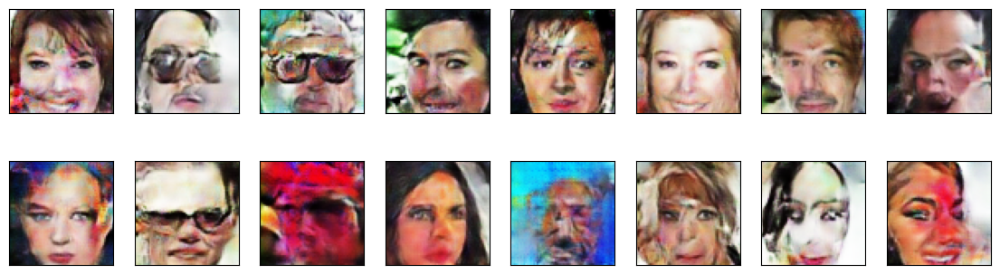

2024-01-20 14:41:35 | Epoch [47/50] | Batch 0/509 | d_loss: 0.0386 | g_loss: 6.8726
2024-01-20 14:41:38 | Epoch [47/50] | Batch 50/509 | d_loss: 0.0443 | g_loss: 4.1914
2024-01-20 14:41:41 | Epoch [47/50] | Batch 100/509 | d_loss: 0.0733 | g_loss: 6.2140
2024-01-20 14:41:44 | Epoch [47/50] | Batch 150/509 | d_loss: 0.0355 | g_loss: 8.4545
2024-01-20 14:41:47 | Epoch [47/50] | Batch 200/509 | d_loss: 0.2703 | g_loss: 5.2437
2024-01-20 14:41:50 | Epoch [47/50] | Batch 250/509 | d_loss: 0.3027 | g_loss: 2.5345
2024-01-20 14:41:53 | Epoch [47/50] | Batch 300/509 | d_loss: 0.4526 | g_loss: 3.4782
2024-01-20 14:41:56 | Epoch [47/50] | Batch 350/509 | d_loss: 0.1214 | g_loss: 5.6518
2024-01-20 14:41:59 | Epoch [47/50] | Batch 400/509 | d_loss: 0.1421 | g_loss: 6.3135
2024-01-20 14:42:02 | Epoch [47/50] | Batch 450/509 | d_loss: 0.3597 | g_loss: 3.0927
2024-01-20 14:42:05 | Epoch [47/50] | Batch 500/509 | d_loss: 0.3239 | g_loss: 2.9512


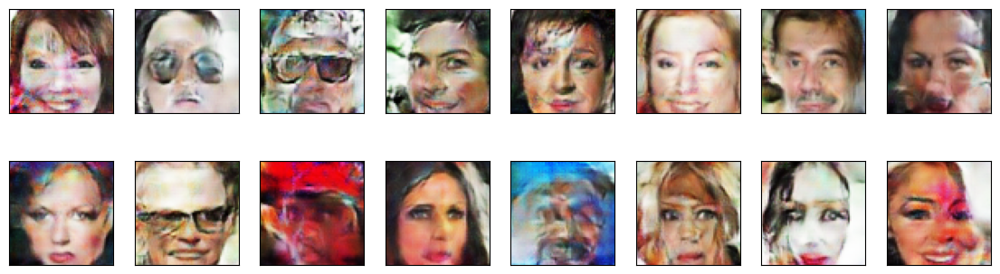

2024-01-20 14:42:06 | Epoch [48/50] | Batch 0/509 | d_loss: 0.3027 | g_loss: 3.5625
2024-01-20 14:42:09 | Epoch [48/50] | Batch 50/509 | d_loss: 0.1258 | g_loss: 4.7899
2024-01-20 14:42:12 | Epoch [48/50] | Batch 100/509 | d_loss: 0.0310 | g_loss: 5.5853
2024-01-20 14:42:15 | Epoch [48/50] | Batch 150/509 | d_loss: 0.0541 | g_loss: 5.1072
2024-01-20 14:42:17 | Epoch [48/50] | Batch 200/509 | d_loss: 0.2008 | g_loss: 4.6380
2024-01-20 14:42:20 | Epoch [48/50] | Batch 250/509 | d_loss: 0.2665 | g_loss: 4.3793
2024-01-20 14:42:23 | Epoch [48/50] | Batch 300/509 | d_loss: 0.1879 | g_loss: 1.5253
2024-01-20 14:42:26 | Epoch [48/50] | Batch 350/509 | d_loss: 0.1141 | g_loss: 4.1932
2024-01-20 14:42:29 | Epoch [48/50] | Batch 400/509 | d_loss: 0.0144 | g_loss: 4.5628
2024-01-20 14:42:32 | Epoch [48/50] | Batch 450/509 | d_loss: 0.4531 | g_loss: 3.5185
2024-01-20 14:42:35 | Epoch [48/50] | Batch 500/509 | d_loss: 0.0278 | g_loss: 5.6647


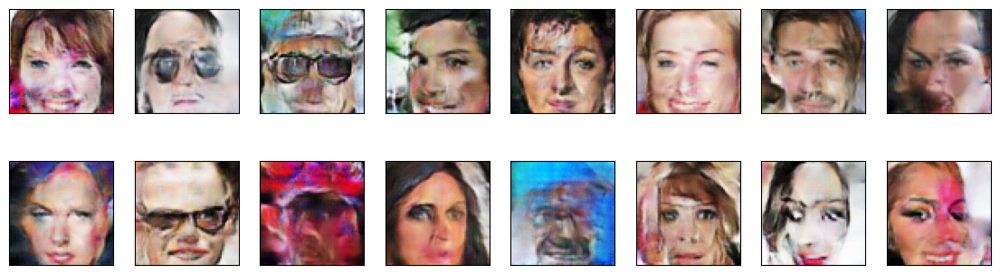

2024-01-20 14:42:36 | Epoch [49/50] | Batch 0/509 | d_loss: 0.0715 | g_loss: 4.2891
2024-01-20 14:42:39 | Epoch [49/50] | Batch 50/509 | d_loss: 0.7691 | g_loss: 4.7160
2024-01-20 14:42:42 | Epoch [49/50] | Batch 100/509 | d_loss: 0.0590 | g_loss: 6.0642
2024-01-20 14:42:45 | Epoch [49/50] | Batch 150/509 | d_loss: 0.1242 | g_loss: 2.1646
2024-01-20 14:42:48 | Epoch [49/50] | Batch 200/509 | d_loss: 0.0584 | g_loss: 4.0181
2024-01-20 14:42:51 | Epoch [49/50] | Batch 250/509 | d_loss: 0.1556 | g_loss: 8.7313
2024-01-20 14:42:54 | Epoch [49/50] | Batch 300/509 | d_loss: 0.0641 | g_loss: 4.4380
2024-01-20 14:42:57 | Epoch [49/50] | Batch 350/509 | d_loss: 0.0207 | g_loss: 11.9754
2024-01-20 14:43:00 | Epoch [49/50] | Batch 400/509 | d_loss: 0.2523 | g_loss: 4.1669
2024-01-20 14:43:02 | Epoch [49/50] | Batch 450/509 | d_loss: 0.0331 | g_loss: 3.3278
2024-01-20 14:43:05 | Epoch [49/50] | Batch 500/509 | d_loss: 0.0365 | g_loss: 3.3654


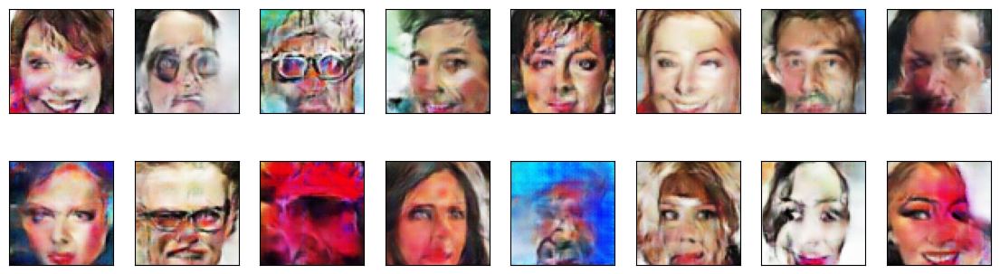

2024-01-20 14:43:07 | Epoch [50/50] | Batch 0/509 | d_loss: 0.0342 | g_loss: 2.8735
2024-01-20 14:43:10 | Epoch [50/50] | Batch 50/509 | d_loss: 0.0414 | g_loss: 7.1915
2024-01-20 14:43:13 | Epoch [50/50] | Batch 100/509 | d_loss: 0.0110 | g_loss: 7.9431
2024-01-20 14:43:16 | Epoch [50/50] | Batch 150/509 | d_loss: 0.0195 | g_loss: 3.8729
2024-01-20 14:43:18 | Epoch [50/50] | Batch 200/509 | d_loss: 0.0053 | g_loss: 4.7394
2024-01-20 14:43:21 | Epoch [50/50] | Batch 250/509 | d_loss: 0.0293 | g_loss: 4.4626
2024-01-20 14:43:24 | Epoch [50/50] | Batch 300/509 | d_loss: 0.3735 | g_loss: 4.1416
2024-01-20 14:43:27 | Epoch [50/50] | Batch 350/509 | d_loss: 0.0919 | g_loss: 5.6087
2024-01-20 14:43:30 | Epoch [50/50] | Batch 400/509 | d_loss: 0.2792 | g_loss: 3.9460
2024-01-20 14:43:33 | Epoch [50/50] | Batch 450/509 | d_loss: 0.0478 | g_loss: 4.9777
2024-01-20 14:43:36 | Epoch [50/50] | Batch 500/509 | d_loss: 0.0353 | g_loss: 3.0601


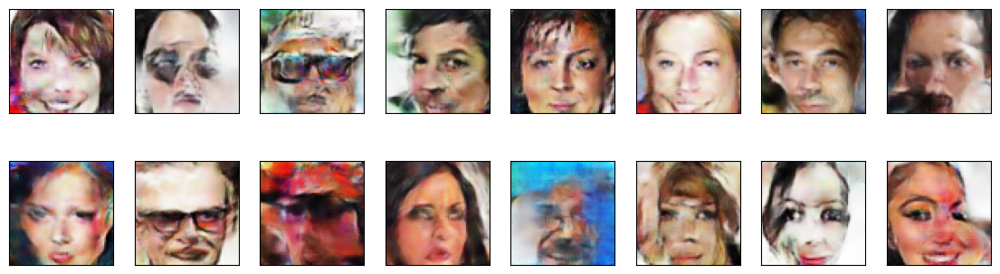

In [27]:
fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).float().cuda()

losses = []
for epoch in range(n_epochs):
    for batch_i, real_images in enumerate(dataloader):
        real_images = real_images.to(device)
        
        ####################################
                
        # ============================================
        #            TRAIN THE DISCRIMINATOR
        # ============================================
        
        d_loss = discriminator_step(batch_size, latent_dim, real_images)
        
#         d_optimizer.zero_grad()
        
#         # 1. Train with real images

#         # Compute the discriminator losses on real images 
        
#         D_real = discriminator(real_images)
#         # d_real_loss = real_loss(D_real)
        
#         # 2. Train with fake images
        
#         # Generate fake images
#         z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
#         z = torch.from_numpy(z).float()[:,:,None,None]
        
#         # z = torch.rand(batch_size, latent_dim, 1, 1) * 2 - 1                
        
#         # z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
#         # z = torch.from_numpy(z).float()
#         z = z.to(device)
        
#         fake_images = generator(z)
        
#         # Compute the discriminator losses on fake images            
#         D_fake = discriminator(fake_images)
#         # d_fake_loss = fake_loss(D_fake)
        
#         # add up loss and perform backprop
#         # d_loss = d_real_loss + d_fake_loss
        
#         d_loss = discriminator_loss(D_real, D_fake)
        
#         d_loss.backward()
        
#         d_optimizer.step()
        
        
        # =========================================
        #            TRAIN THE GENERATOR
        # =========================================
        
        g_loss = generator_step(batch_size, latent_dim)
        
#         g_optimizer.zero_grad()
        
#         # 1. Train with fake images and flipped labels
        
#         # Generate fake images
#         z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
#         z = torch.from_numpy(z).float()[:,:,None,None]
                
#         # z = torch.rand(batch_size, latent_dim, 1, 1) * 2 - 1
        
#         # z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
#         # z = torch.from_numpy(z).float()
                
#         z = z.to(device)
        
#         fake_images = generator(z)
        
#         # Compute the discriminator losses on fake images 
#         # using flipped labels!
#         D_fake = discriminator(fake_images)
                        
#         # g_loss = real_loss(D_fake) # use real loss to flip labels
#         g_loss = generator_loss(D_fake)
        
#         # perform backprop
#         g_loss.backward()
        
#         g_optimizer.step()

        # # Print some loss stats
        # if batch_i % print_every == 0:
        #     # append discriminator loss and generator loss
        #     losses.append((d_loss.item(), g_loss.item()))
        #     # print discriminator and generator loss
        #     print('Epoch [{:5d}/{:5d}] | d_loss: {:6.4f} | g_loss: {:6.4f}'.format(
        #             epoch+1, n_epochs, d_loss.item(), g_loss.item()))

            
        ####################################
        
        if batch_i % print_every == 0:
            # append discriminator loss and generator loss
            d = d_loss['loss'].item()
            g = g_loss['loss'].item()
            losses.append((d, g))
            # print discriminator and generator loss
            time = str(datetime.now()).split('.')[0]
            print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
    
    # display images during training
    generator.eval()
    generated_images = generator(fixed_latent_vector)
    display(generated_images)
    generator.train()

### Training losses

Plot the training losses for the generator and discriminator.

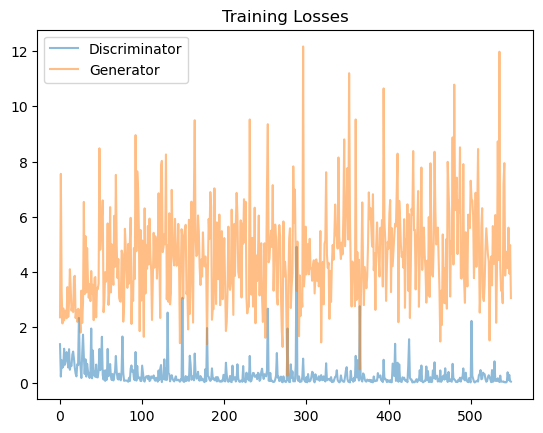

In [28]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

### Question: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* The dataset is biased; it is made of "celebrity" faces that are mostly white
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result
* Loss functions

**Answer:** (Write your answer in this cell)

About the dataset, perhaps there is bias, although the 20 samples in the beginning of the notebook does have an interesting coverage at least accross genders. Races not so much. 
Nevertheless, I believe a bigger dataset could give better results.

In terms of experiments, I started with architecture and hyperparameters something based on DCGAN paper, to avoid some of the GAN training instability that's usually mentioned on related documentation and on the course material.

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb".  

Submit the notebook using the ***SUBMIT*** button in the bottom right corner of the Project Workspace.